## Оценка риска ДТП по выбранному маршруту движения

Вы — специалист по Data Sciense в каршеринговой компании. Вам поступил заказ: нужно создать систему, которая могла бы оценить риск ДТП по выбранному маршруту движения. 

Под риском понимается вероятность ДТП с любым повреждением транспортного средства. Как только водитель забронировал автомобиль, сел за руль и выбрал маршрут, система должна оценить уровень риска. Если уровень риска высок, водитель увидит предупреждение и рекомендации по маршруту.

Идея создания такой системы находится в стадии предварительного обсуждения и проработки. Чёткого алгоритма работы и подобных решений на рынке ещё не существует. Текущая задача — понять, возможно ли предсказывать ДТП, опираясь на исторические данные одного из регионов.

Заказчик предлагает вам поработать с базой данных по происшествиям и сформировать свои идеи создания такой системы. Идея решения задачи от заказчика: 

1. Создать модель предсказания ДТП (целевое значение — at_fault (виновник) в таблице parties)
    - Для модели выбрать тип виновника — только машина (car).
    - Выбрать случаи, когда ДТП привело к любым повреждениям транспортного средства, кроме типа SCRATCH (царапина).
    - Для моделирования ограничиться данными за 2012 год — они самые свежие.
    - Обязательное условие — учесть фактор возраста автомобиля.
    
    
2. На основе модели исследовать основные факторы ДТП.


3. Понять, помогут ли результаты моделирования и анализ важности факторов ответить на вопросы:
    - Возможно ли создать адекватную системы оценки водительского риска при выдаче авто?
    - Какие ещё факторы нужно учесть?
    - Нужно ли оборудовать автомобиль какими-либо датчиками или камерой?


План по выполнению проекта

**Шаг 1. Загрузим таблицы sql**

Подключимся к базе данных, используя данные:

db_config = {<br/>
'user': 'praktikum_student', # имя пользователя,<br/>
'pwd': 'Sdf4$2;d-d30pp', # пароль,<br/>
'host': 'rc1b-wcoijxj3yxfsf3fs.mdb.yandexcloud.net',<br/>
'port': 6432, # порт подключения,<br/>
'db': 'data-science-vehicle-db' # название базы данных,<br/>
} <br/>

 **Шаг 2. Проведем первичное исследование таблиц**

- Все ли таблицы имеют набор данных;
- Соответствует ли количество таблиц условию задачи;
- Имеется ли общий ключ для связи таблиц.<br/>

Для осмотра таблиц используйте sql-запрос.

**Шаг 3. Проведем статистический анализ факторов ДТП**

1. Выясним, в какие месяцы происходит наибольшее количество аварий, проанализировав весь период наблюдений (таблица collisions).
    - Создадим sql-запрос;
    - Построим график;
    - Сделаем вывод.
    
2. Скоро состоится первое совещание вашей рабочей группы. Чтобы обсуждение было конструктивным, каждый сотрудник должен понимать данные. Для этого создадим подходящие аналитические задачи и поручим их решение коллегам. Примеры задач:
    - Проведите анализ серьёзности повреждений транспортного средства, исходя из состояния дороги в момент ДТП (связать collisions и parties);
    - Найдите самые частые причины ДТП (таблица parties).
    
2.1. Создадим не менее шести задач для коллег. Опирайтесь на примеры и таблицы. 

2.2. Пропишем порядок решения для двух задач из списка. Обязательное условие — решение этих задач должно включать связь не менее 2-х таблиц. Пример прописанного порядка:
    - Создайте sql-запрос;
    - Постройте график;
    - Сделайте вывод.
    
**Шаг 4. Создадим модель для оценки водительского риска**
1. Подготовим набор данных на основе первичного предположения заказчика:
 
    - Выберем тип виновника — только машина (car). **
    - Возьмем случаи, когда ДТП привело к любым значимым повреждениям автомобиля любого из участников — все, кроме типа SCRATCH (царапина).
    - Для моделирования возьмем данные только за 2012 год.
    - Подготовка исходной таблицы должна проводиться с помощью sql-запроса.
2. Проведем первичный отбор факторов, необходимых для модели.
Изучим описание факторов. Нужно отобрать те, которые могут влиять на вероятность ДТП. Аргументируем свой выбор. 

Пример:<br/>

columms =['party_type',     # Тип участника происшествия. Таблица parties<br/>
          'party_sobriety', # Уровень трезвости виновника (точно может влиять) Таблица parties<br/>
           ......]<br/> 
         
3. Проведем статистическое исследование отобранных факторов.
    - По результату исследовательского анализа внесем корректировки, если они нужны. Сделаем вывод.
    - Если необходимо, категоризируем исходные данные, проведем масштабирование.
    - Подготовим обучающую и тестовую выборки.
    
**Шаг 5. Найдем лучшую модель**

1. Смоделируем не менее 3-х типов моделей с перебором гиперпараметров.
2. 1–2 модели из спринта 2;
3. 1–2 модели из спринта 3.
4. Выберем метрику для оценки модели, исходя из поставленной бизнесом задачи, обосновав свой выбор.
5. Оформим вывод в виде сравнительной таблицы.

**Шаг 6. Проверим лучшую модель в работе**

1. Проведем графический анализ «Матрица ошибок». Выведем полноту и точность на график.
2. Проанализируем важность основных факторов, влияющих на вероятность ДТП.
3. Для одного из выявленных важных факторов проведем дополнительное исследование:
    - Покажем график зависимости фактора и целевой переменной.
    - Предложим, чем можно оборудовать автомобиль, чтобы учесть этот фактор во время посадки водителя.

**Шаг 7. Сделаем общий вывод по модели**
    - Кратко опишем лучшую модель.
    - Сделаем вывод: насколько возможно создание адекватной системы оценки риска при выдаче авто?
    - Какие факторы ещё необходимо собирать, чтобы улучшить модель?

**Оформление:** Выполните задание в Jupyter Notebook. Заполните программный код в ячейках типа code, текстовые пояснения — в ячейках типа markdown. Примените форматирование и заголовки.

Краткое описание таблиц

**collisions — общая информация о ДТП**

Имеет уникальный case_id. Эта таблица описывает общую информацию о ДТП. Например, где оно произошло и когда.

**parties — информация об участниках ДТП**

Имеет неуникальный case_id, который сопоставляется с соответствующим ДТП в таблице collisions. Каждая строка здесь описывает одну из сторон, участвующих в ДТП. Если столкнулись две машины, в этой таблице должно быть две строки с совпадением case_id. Если нужен уникальный идентификатор, это case_id and party_number.

**vehicles — информация о пострадавших машинах**

Имеет неуникальные case_id и неуникальные party_number, которые сопоставляются с таблицей collisions и таблицей parties. Если нужен уникальный идентификатор, это case_id and party_number.


## Подключитесь к базе. Загрузите таблицы sql

### Загрузка библиотек

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import lightgbm as lgb
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
import statistics as st


import math
import phik
import random
import shap
import time
import xgboost


from phik.report import plot_correlation_matrix
from sqlalchemy import create_engine

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_recall_curve, PrecisionRecallDisplay
from sklearn.metrics import f1_score, precision_score, recall_score
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import OrdinalEncoder, StandardScaler

from catboost import CatBoostClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier

SEED = 12345

pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [3]:
def df_info(df, name):
    
    '''Подробная информация о конкретном DF'''
    
    df.name = name
    
    print(f'Информация о {df.name} (кол-во столбцов {df.shape[1]}, кол-во строк {df.shape[0]})')
    print()
    
    display(df.head(10), df.info(memory_usage = True), df.describe().transpose())

def data_spread(df, column_list):
    
    '''Разброс данных. Отображение диаграммы размаха и гистограммы. Входные данные list колонок и df'''
    
    for column in column_list:
        df.boxplot(column=column)
        plt.title(f'Диаграмма размаха на столбце {column}')
        plt.show()
        df[column].plot(kind='hist', bins=100, grid=True)
        plt.title(f'Гистограмма на столбце {column}')
        plt.xlabel(column)
        plt.ylabel('Кол-во наблюдений')
        plt.show()
        print('--------------------------------------------')
        
def uniqueness(df, column_list):
    
    '''Просмотр уникальных значений листа'''
    
    for column in column_list:
        print(f'Количество уникальных значений столбца {column}: {df[column].nunique()}')
        print(df[column].unique())
        print('-----------------------------')
        
def learning_time(model, features_train, target_train):
    '''Считает время обучения модели'''
    start = time.time()
    model.fit(features_train, target_train)
    end = time.time()
    learning_time = end - start
    return model, learning_time

def predict_time(model, features_test):
    '''Считает время предсказания модели'''
    start = time.time()
    predicts = model.predict(features_test)
    end = time.time()
    predict_time = end - start
    return predicts, predict_time

def alter_table(df, model, recall, learning_time, predic_time):
    '''Добавляет в нашу таблицу с анализом моделей данные'''
    
    analytics.loc[model, 'Recall'] = recall
    analytics.loc[model, 'LearningTime'] = learning_time
    analytics.loc[model, 'PredictTime'] = predic_time
    
    return df

### Подключение к базе данных

In [4]:
db_config = {
'user': 'praktikum_student', # имя пользователя,
'pwd': 'Sdf4$2;d-d30pp', # пароль,
'host': 'rc1b-wcoijxj3yxfsf3fs.mdb.yandexcloud.net',
'port': 6432, # порт подключения,
'db': 'data-science-vehicle-db' # название базы данных,
} 

In [5]:
# Создание строки для соединения

connection_string = 'postgresql://{}:{}@{}:{}/{}'.format(
    db_config['user'],
    db_config['pwd'],
    db_config['host'],
    db_config['port'],
    db_config['db'],
) 

In [6]:
# Создадим соединение
engine = create_engine(connection_string)

## Проведение первичного исследования таблиц

In [7]:
query = '''
SELECT table_name
FROM information_schema.tables
WHERE table_schema NOT IN ('information_schema','pg_catalog');
'''
df = pd.read_sql_query(query, con=engine)
df

,table_name
0,case_ids
1,collisions
2,parties
3,vehicles


Посмотрим какие колонки имеются в наших таблицах и какой тип данных они имеют.

In [8]:
query = '''
SELECT table_name, 
       column_name, 
       data_type 
FROM information_schema.columns
WHERE table_name IN ('case_ids', 'collisions', 'parties', 'vehicles');
'''
df = pd.read_sql_query(query, con=engine)
df

,table_name,column_name,data_type
0,case_ids,case_id,text
1,case_ids,db_year,text
2,collisions,case_id,text
3,collisions,county_city_location,text
4,collisions,county_location,text
5,collisions,distance,real
6,collisions,direction,text
7,collisions,intersection,integer
8,collisions,weather_1,text
9,collisions,location_type,text


Посмотрим на первичные и внешние ключи.

In [9]:
query = '''
SELECT constraint_name,
       table_name,
       column_name
FROM information_schema.key_column_usage
'''
df = pd.read_sql_query(query, con=engine)
df

,constraint_name,table_name,column_name
0,case_ids_pk,case_ids,case_id
1,parties_pk,parties,id
2,vehicles_pk,vehicles,id
3,collisions_case_ids_case_id_fk,collisions,case_id
4,parties_case_ids_case_id_fk,parties,case_id
5,vehicles_case_ids_case_id_fk,vehicles,case_id


In [10]:
collisions = '''

SELECT *
FROM collisions

'''

parties = '''

SELECT *
FROM parties

'''

vehicles = '''

SELECT *
FROM vehicles

'''

case_ids = '''

SELECT *
FROM case_ids

'''

Выгрузим таблицу collisions в датафрейм и запросим информацию о ней

In [11]:
collisions = pd.read_sql_query(collisions, con = engine)

In [12]:
df_info(collisions, 'collisions')

Информация о collisions (кол-во столбцов 20, кол-во строк 1400000)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1400000 entries, 0 to 1399999
Data columns (total 20 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   case_id                      1400000 non-null  object 
 1   county_city_location         1400000 non-null  object 
 2   county_location              1400000 non-null  object 
 3   distance                     1400000 non-null  float64
 4   direction                    1059358 non-null  object 
 5   intersection                 1387781 non-null  float64
 6   weather_1                    1392741 non-null  object 
 7   location_type                518779 non-null   object 
 8   collision_damage             1400000 non-null  object 
 9   party_count                  1400000 non-null  int64  
 10  primary_collision_factor     1391834 non-null  object 
 11  pcf_violation_category       13720

,case_id,county_city_location,county_location,distance,direction,intersection,weather_1,location_type,collision_damage,party_count,primary_collision_factor,pcf_violation_category,type_of_collision,motor_vehicle_involved_with,road_surface,road_condition_1,lighting,control_device,collision_date,collision_time
0,4083072,1942,los angeles,528.00,north,0.00,cloudy,highway,small damage,2,vehicle code violation,unsafe lane change,sideswipe,other motor vehicle,wet,normal,daylight,none,2009-01-22,07:25:00
1,4083075,4313,santa clara,0.00,None,1.00,clear,None,small damage,1,vehicle code violation,improper passing,hit object,fixed object,dry,normal,dark with street lights,functioning,2009-01-03,02:26:00
2,4083073,0109,alameda,0.00,None,1.00,clear,None,scratch,2,vehicle code violation,improper turning,broadside,other motor vehicle,dry,normal,dark with street lights,functioning,2009-01-11,03:32:00
3,4083077,0109,alameda,0.00,None,1.00,clear,None,scratch,2,vehicle code violation,automobile right of way,broadside,other motor vehicle,dry,normal,daylight,functioning,2009-01-11,10:35:00
4,4083087,4313,santa clara,0.00,None,1.00,clear,None,scratch,2,vehicle code violation,speeding,rear end,other motor vehicle,dry,None,dark with street lights,functioning,2009-01-02,22:43:00
5,4083097,0109,alameda,0.00,None,1.00,clear,ramp,small damage,2,vehicle code violation,speeding,rear end,other motor vehicle,dry,normal,dark with street lights,functioning,2009-01-18,02:18:00
6,4083092,1942,los angeles,1320.00,south,0.00,clear,highway,scratch,2,vehicle code violation,unsafe lane change,rear end,other motor vehicle,dry,normal,daylight,none,2009-01-21,10:30:00
7,4083096,1942,los angeles,200.00,south,0.00,clear,highway,scratch,3,vehicle code violation,speeding,rear end,other motor vehicle,dry,normal,daylight,none,2009-01-21,08:55:00
8,4083100,1942,los angeles,2112.00,north,0.00,cloudy,highway,scratch,2,vehicle code violation,speeding,rear end,other motor vehicle,dry,normal,daylight,none,2009-01-21,16:20:00
9,4083103,4313,santa clara,0.00,None,1.00,cloudy,None,scratch,2,vehicle code violation,None,broadside,other motor vehicle,wet,normal,dusk or dawn,functioning,2009-01-02,15:55:00


None

,count,mean,std,min,25%,50%,75%,max
distance,1400000.00,660.71,11785.79,0.00,2.00,100.00,430.00,8363520.00
intersection,1387781.00,0.22,0.42,0.00,0.00,0.00,0.00,1.00
party_count,1400000.00,1.97,0.67,1.00,2.00,2.00,2.00,27.00


Выгрузим таблицу parties в датафрейм и запросим информацию о ней

In [13]:
parties = pd.read_sql_query(parties, con = engine)

In [14]:
df_info(parties, 'parties')

Информация о parties (кол-во столбцов 9, кол-во строк 2752408)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2752408 entries, 0 to 2752407
Data columns (total 9 columns):
 #   Column               Dtype  
---  ------               -----  
 0   id                   int64  
 1   case_id              object 
 2   party_number         int64  
 3   party_type           object 
 4   at_fault             int64  
 5   insurance_premium    float64
 6   party_sobriety       object 
 7   party_drug_physical  object 
 8   cellphone_in_use     float64
dtypes: float64(2), int64(3), object(4)
memory usage: 189.0+ MB


,id,case_id,party_number,party_type,at_fault,insurance_premium,party_sobriety,party_drug_physical,cellphone_in_use
0,22,3899454,1,road signs,1,29.00,had not been drinking,None,0.00
1,23,3899454,2,road signs,0,7.00,had not been drinking,None,0.00
2,29,3899462,2,car,0,21.00,had not been drinking,None,0.00
3,31,3899465,2,road signs,0,24.00,had not been drinking,None,0.00
4,41,3899478,2,road bumper,0,NaN,not applicable,not applicable,0.00
5,43,3899481,2,road bumper,0,NaN,not applicable,not applicable,0.00
6,72,3899505,2,road bumper,0,NaN,not applicable,not applicable,0.00
7,73,3899505,3,road bumper,0,NaN,not applicable,not applicable,0.00
8,76,3899509,1,road bumper,0,NaN,had not been drinking,None,0.00
9,93,3981292,2,road bumper,0,NaN,had not been drinking,None,NaN


None

,count,mean,std,min,25%,50%,75%,max
id,2752408.00,1376204.50,794551.89,1.00,688102.75,1376204.50,2064306.25,2752408.00
party_number,2752408.00,1.60,0.72,1.00,1.00,1.00,2.00,27.00
at_fault,2752408.00,0.47,0.50,0.00,0.00,0.00,1.00,1.00
insurance_premium,2347006.00,38.75,16.38,0.00,25.00,36.00,50.00,105.00
cellphone_in_use,2240771.00,0.02,0.14,0.00,0.00,0.00,0.00,1.00


Выгрузим таблицу vehicles в датафрейм и запросим информацию о ней

In [15]:
vehicles = pd.read_sql_query(vehicles, con = engine)

In [16]:
df_info(vehicles, 'vehicles')

Информация о vehicles (кол-во столбцов 6, кол-во строк 1021234)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1021234 entries, 0 to 1021233
Data columns (total 6 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   id                    1021234 non-null  int64  
 1   case_id               1021234 non-null  object 
 2   party_number          1021234 non-null  int64  
 3   vehicle_type          1021234 non-null  object 
 4   vehicle_transmission  997575 non-null   object 
 5   vehicle_age           996652 non-null   float64
dtypes: float64(1), int64(2), object(3)
memory usage: 46.7+ MB


,id,case_id,party_number,vehicle_type,vehicle_transmission,vehicle_age
0,1175713,5305032,2,sedan,manual,3.00
1,1,3858022,1,sedan,auto,3.00
2,1175712,5305030,1,sedan,auto,3.00
3,1175717,5305033,3,sedan,auto,5.00
4,1175722,5305034,2,sedan,auto,5.00
5,1175737,5305046,2,sedan,auto,5.00
6,1175750,5305053,3,sedan,auto,9.00
7,1175715,5305033,1,sedan,manual,10.00
8,1175716,5305033,2,sedan,manual,4.00
9,1175758,5305060,2,sedan,auto,11.00


None

,count,mean,std,min,25%,50%,75%,max
id,1021234.00,760162.80,438619.36,1.00,380694.25,761762.50,1141347.75,1517654.00
party_number,1021234.00,1.61,0.68,1.00,1.00,2.00,2.00,27.00
vehicle_age,996652.00,5.14,3.11,0.00,3.00,5.00,7.00,161.00


In [17]:
case_ids = pd.read_sql_query(case_ids, con = engine)
df_info(case_ids, 'case_ids')

Информация о case_ids (кол-во столбцов 2, кол-во строк 1400000)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1400000 entries, 0 to 1399999
Data columns (total 2 columns):
 #   Column   Non-Null Count    Dtype 
---  ------   --------------    ----- 
 0   case_id  1400000 non-null  object
 1   db_year  1400000 non-null  object
dtypes: object(2)
memory usage: 21.4+ MB


,case_id,db_year
0,0081715,2021
1,0726202,2021
2,3858022,2021
3,3899441,2021
4,3899442,2021
5,3899445,2021
6,3899446,2021
7,3899449,2021
8,3899450,2021
9,3899453,2021


None

,count,unique,top,freq
case_id,1400000,1400000,0081715,1
db_year,1400000,1,2021,1400000


Похоже, что в таблице collisions отсутствует первичный ключ. Проверим уникальность значений столбца case_id.

In [18]:
query = '''
SELECT COUNT(case_id) AS total_ids,
       COUNT(DISTINCT case_id) AS unique_ids
FROM collisions;
'''
df = pd.read_sql_query(query, con=engine)
df

,total_ids,unique_ids
0,1400000,1400000


Значения уникальны.

Также стоит отметить, что первичный ключ в таблицах parties и vehicles не совпадает с внешним ключом к таблице case_ids, т.к. одному case_id может быть сопоставлено несколько id из этих таблиц.

Проверим пересечение уникальных значений case_id в каждом датафрейме с case_ids

In [19]:
print('Разность case_ids и collisions =', len(case_ids['case_id']) - len(list(set(case_ids['case_id']) & set(collisions['case_id'].unique()))))
print('Разность case_ids и parties =', len(case_ids['case_id']) - len(list(set(case_ids['case_id']) & set(parties['case_id'].unique()))))
print('Разность case_ids и vehicles =', len(case_ids['case_id']) - len(list(set(case_ids['case_id']) & set(vehicles['case_id'].unique()))))

Разность case_ids и collisions = 0
Разность case_ids и parties = 0
Разность case_ids и vehicles = 607358


**Вывод**

 - Все таблицы имеют набор данных;
 - Количество таблиц соответствует условию задачи;
 - Общий ключ для связи таблиц имеется.
 
От заказчика исследования нам предоставлена база данных с описанием дорожно транспортных проишествий в виде четырех таблиц, одна из которых является связывающей (case_ids), остальные - информационные, которые несут в себе характиристики машины (Vehicles), участников (Parties) и самого проишествия (Collisions). 

Все таблицы имеют данные, необходимые для обучения моделей и решения поставленной задачи. Представленных наблюдений около 1.400.000, что будет лишь положительно влиять на обучение. Однако, все таблицы связаны одним столбцом case_id, и если говорить про разность ключа таблицы case_ids со всеми оставшимися, то в vehicles будет найдено 607.358 несовпадений, что сократит нашу выборку почти в два раза, а при последующий срезах еще выше.

Нас просят предсказать риск проишествия по маршруту, но представлены данные только о проишествиях, поэтому если нам предстоит предсказывать безопасность пассажиров в автомобиле, тогда нам понадорбятся все наблюдения, включающие в себя удачно завершенные поездки - без проишествий.

##  Проведите статистический анализ факторов ДТП

Выясним, в какие месяцы происходит наибольшее количество аварий, проанализировав весь период наблюдений (таблица collisions).

In [20]:
query = """

SELECT DISTINCT EXTRACT(MONTH FROM collision_date) accidents_month,
      COUNT(case_id) total_collisions
FROM collisions
GROUP BY accidents_month;
"""

count_collisions = pd.read_sql_query(query, con = engine)

# Создадим словарь для месяцев
month_list = {1 : 'Январь',
              2 : 'Февраль',
              3 : 'Март',
              4 : 'Апрель',
              5 : 'Май',
              6 : 'Июнь',
              7 : 'Июль',
              8 : 'Август',
              9 : 'Сентябрь',
              10 : 'Октябрь',
              11 : 'Ноябрь',
              12 : 'Декабрь'} 

count_collisions = count_collisions.reset_index(drop=True)

# Замена названий месяцев
count_collisions['accidents_month'] = count_collisions['accidents_month'].replace(month_list)

# Замена индексов на месяцы
count_collisions = count_collisions.set_index('accidents_month')
count_collisions

,total_collisions
accidents_month,
Январь,132044
Февраль,128858
Март,139581
Апрель,130180
Май,130316
Июнь,102594
Июль,102227
Август,104089
Сентябрь,105159


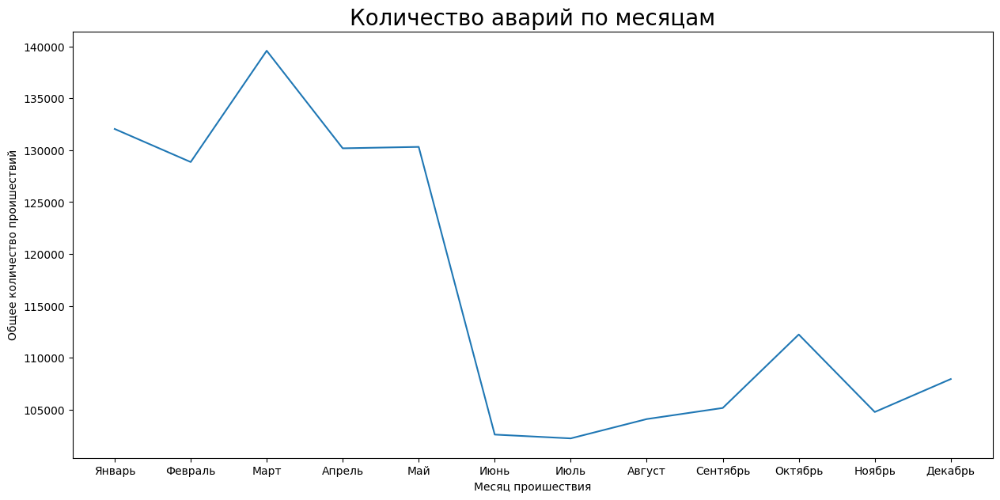

In [21]:
fig, ax = plt.subplots()
fig.set_figwidth(15)
fig.set_figheight(7)
ax.plot(count_collisions.index, count_collisions['total_collisions'])
ax.set_title('Количество аварий по месяцам', fontsize=20)
ax.set_xlabel('Месяц проишествия')
ax.set_ylabel('Общее количество проишествий')
plt.show()

Согласно полученным данным наибольшее количество аварий приходится на март.

In [22]:
query = '''
SELECT COUNT(case_id) AS total_ids,
       DATE_TRUNC('month', collision_date)::date AS month
FROM collisions
GROUP BY DATE_TRUNC('month', collision_date)
ORDER BY DATE_TRUNC('month', collision_date);
'''
df = pd.read_sql_query(query, con=engine)

In [23]:
fig = px.bar(
    df, x='month', y='total_ids',
    barmode='group',
    title=('Статистика происшествий по месяцам')
)
fig.show()

Дополнительно изобразил график с данными по периодам. Из графика видно, что статистика собрана в полной мере только до мая 2012, затем в данных существенный провис.<br />

Если рассматривать зону с большим покрытием (до мая 2012), то видно несколько трендов:<br />

- меньшее количество аварий происходит в январе-феврале;
- пик аварий все три года приходится на октябрь, что может быть связано с первыми заморозками и снегом, а также не успевшими адаптироваться водителями;

Скоро состоится первое совещание вашей рабочей группы. Чтобы обсуждение было конструктивным, каждый сотрудник должен понимать данные. Создадим не менее шести задач для коллег.
Пропишем порядок решения для двух задач из списка. Обязательное условие — решение этих задач должно включать связь не менее 2-х таблиц. Пример прописанного порядка:
- Создайте sql-запрос;
- Постройте график;
- Сделайте вывод.

1. Оценить серьёзность повреждений ТС, исходя из состояния водителя;
2. Оцените сумму страховых выплат в зависимости от возраста автомобиля;
3. Оцените серьёзность повреждений ТС, исходя из типа участника ДТП;
4. Определите регионы, в которых чаще всего возникают ДТП, для этих регионов определите категории нарушений;
5. Определите серьёзность повреждений ТС в зависимости от года выпуска автомобиля;
6. Оцените влияние освещения на вероятность возникновения ДТП

**Оценка серьёзности повреждений ТС, исходя из состояния водителя**

In [24]:
query = '''
SELECT c.collision_damage,
       p.party_drug_physical
FROM collisions AS c
JOIN parties AS p ON c.case_id = p.case_id
WHERE p.party_drug_physical IN ('not applicable', 'G');
'''
df = pd.read_sql_query(query, con=engine)

In [25]:
fig = px.histogram(
    df, x='party_drug_physical', color='collision_damage',
    barmode='group',
    title='Зависимость тяжести ДТП от физического состояния водителя (количество)',
    histfunc='count',
    category_orders={
        'collision_damage': ['fatal', 'severe damage', 'middle damage', 'small damage', 'scratch']
    }
)
fig.show()

В случаях, когда состояние о физическом состоянии неизвестно или не оценивалось - статистика видов повреждения очень похожа. Большая часть аварий заканчивается малыми повреждениями или царапинами.

In [26]:
query = '''
SELECT c.collision_damage,
       p.party_drug_physical
FROM collisions AS c
JOIN parties AS p ON c.case_id = p.case_id
WHERE p.party_drug_physical IN ('under drug influence', 'sleepy/fatigued', 'impairment - physical');
'''
df = pd.read_sql_query(query, con=engine)

In [27]:
fig = px.histogram(
    df, x='party_drug_physical', color='collision_damage',
    barmode='group',
    title='Зависимость тяжести ДТП от физического состояния водителя (количество)',
    histfunc='count',
    category_orders={
        'collision_damage': ['fatal', 'severe damage', 'middle damage', 'small damage', 'scratch']
    }
)
fig2 = px.histogram(
    df, x='party_drug_physical', color='collision_damage',
    barmode='group',
    title='Зависимость тяжести ДТП от физического состояния водителя (проценты)',
    histfunc='count',
    histnorm='percent',
    category_orders={
        'collision_damage': ['fatal', 'severe damage', 'middle damage', 'small damage', 'scratch']
    }
)
fig.show()
fig2.show()

Количество аварий с фатальными повреждениями ТС существенно выше в случае если водитель находится под воздействием лекарств (на них приходится больше 90% всех случаев), усталость и сонливость почти не влияют на риск ДТП с тяжёлыми последствиями.
Количество ДТП с участниками под лекарственными веществами и в сонном состоянии в количественном соотношении равны. Количество ДТП связанных с ухудшением физического состояния ощутимо меньше.
В целом соотношение типов ДТП совпадает за исключением процента тяжёлых транспортных проишествий.

**Оценка суммы страховых выплат в зависимости от возраста автомобиля**

In [28]:
query = '''

SELECT v.vehicle_age,
       AVG(p.insurance_premium)
FROM vehicles AS v
INNER JOIN parties AS p ON v.case_id = p.case_id
WHERE v.vehicle_age < 100
GROUP BY v.vehicle_age;

'''

df = pd.read_sql_query(query, con = engine)
df.drop_duplicates(inplace=True)

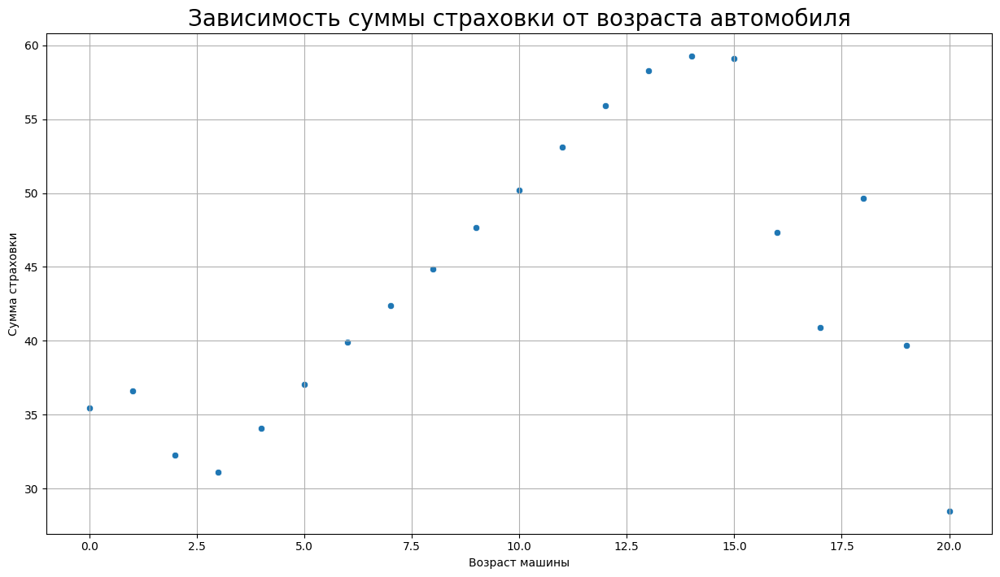


             vehicle_age  avg
vehicle_age         1.00 0.43
avg                 0.43 1.00


In [29]:
plt.figure(figsize=(15, 8))
sns.scatterplot(data=df, x="vehicle_age", y="avg")
plt.title('Зависимость суммы страховки от возраста автомобиля', fontsize=20)
plt.xlabel('Возраст машины')
plt.ylabel('Сумма страховки')
plt.grid(True)
plt.show()

print()

print(df.corr())

Существует определённая зависимость между возрастом автомобиля и суммой страховки - с увеличением возраста сумма выше, чем для новых, однако после достижения 15 лет страховка стремительно уменьшается.

**Определим регионы, в которых чаще всего возникают ДТП**

In [30]:
query = '''

SELECT COUNTY_LOCATION,
       COUNT(CASE_ID)
FROM collisions
GROUP BY COUNTY_LOCATION
ORDER BY COUNT(CASE_ID) DESC;

'''

df = pd.read_sql_query(query, con = engine)
df

,county_location,count
0,los angeles,433809
1,orange,118276
2,san bernardino,79382
3,san diego,78391
4,riverside,69328
5,alameda,64553
6,sacramento,56988
7,santa clara,50786
8,ventura,32335
9,contra costa,31492


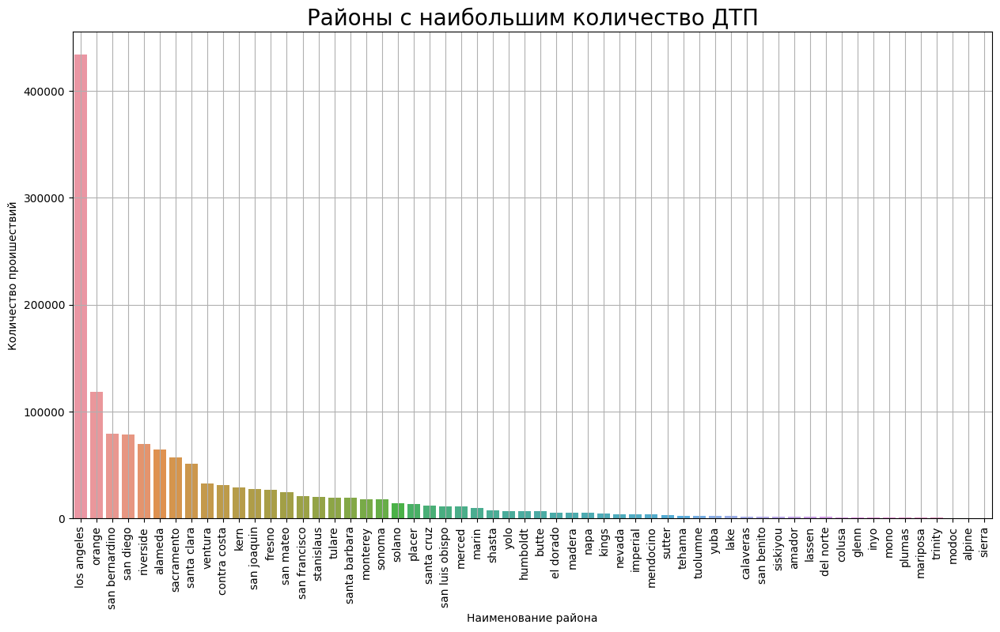

In [31]:
plt.figure(figsize=(15, 8))
sns.barplot(data=df, x="county_location", y="count")
plt.title('Районы с наибольшим количество ДТП', fontsize=20)
plt.xticks(rotation=90)
plt.xlabel('Наименование района')
plt.ylabel('Количество проишествий')
plt.grid(True)
plt.show()

Для выявленных регионов определим самые частые нарущения

In [32]:
violations = '''

WITH a AS 
(SELECT COUNTY_LOCATION,
       COUNT(CASE_ID)
FROM collisions
GROUP BY COUNTY_LOCATION
ORDER BY COUNT(CASE_ID) DESC),

f AS

(SELECT ROW_NUMBER() OVER (PARTITION BY COUNTY_LOCATION ORDER BY COUNT(CASE_ID) DESC),
        COUNTY_LOCATION,
        PCF_VIOLATION_CATEGORY,
        COUNT(CASE_ID)
FROM collisions
GROUP BY COUNTY_LOCATION, PCF_VIOLATION_CATEGORY
ORDER BY COUNTY_LOCATION)

SELECT county_location,
       PCF_VIOLATION_CATEGORY,
       count
FROM f
WHERE row_number < 4 AND county_location IN (SELECT COUNTY_LOCATION
                                          FROM a
                                          LIMIT 10);


'''

violations = pd.read_sql_query(violations, con = engine)
violations

,county_location,pcf_violation_category,count
0,alameda,speeding,20721
1,alameda,improper turning,13408
2,alameda,unsafe lane change,5490
3,contra costa,speeding,9797
4,contra costa,improper turning,5343
5,contra costa,automobile right of way,2556
6,los angeles,speeding,135566
7,los angeles,improper turning,58083
8,los angeles,automobile right of way,57609
9,orange,speeding,42328


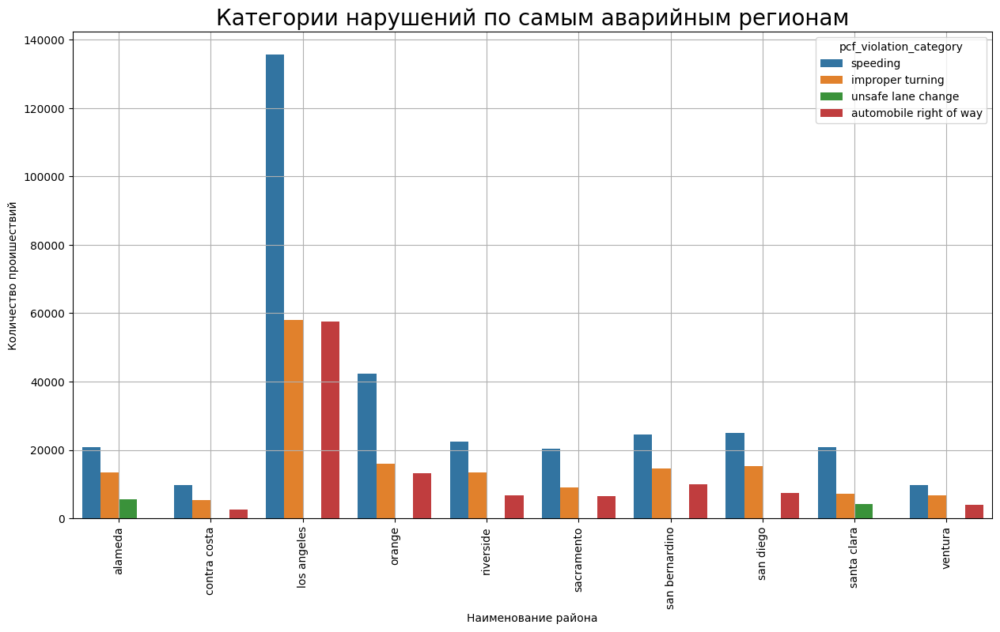

In [33]:
plt.figure(figsize=(15, 8))
sns.barplot(data=violations, x="county_location", y="count", hue = 'pcf_violation_category')
plt.title('Категории нарушений по самым аварийным регионам', fontsize=20)
plt.xticks(rotation=90)
plt.xlabel('Наименование района')
plt.ylabel('Количество проишествий')
plt.grid(True)
plt.show()

Los Angeles, Orange и San Bernardino самые аварийные регионы в предложенных данных. При этом Los Angeles в несколько раз превосходит второй город по количеству ДТП. Самые частые нарушения - превышение скорости.

## Создайте модель для оценки водительского риска

### Создание датафрейма с помощью SQL-запроса

In [34]:
data = '''

SELECT p.party_number,
       v.vehicle_type,
       v.vehicle_transmission,
       v.vehicle_age,
       c.county_city_location,
       c.county_location,
       c.distance,
       c.direction,
       c.intersection,
       c.weather_1,
       c.location_type,
       c.collision_damage,
       c.party_count,
       c.primary_collision_factor,
       c.pcf_violation_category,
       c.type_of_collision,
       c.motor_vehicle_involved_with,
       c.road_surface,
       c.road_condition_1,
       c.lighting,
       c.control_device,
       c.collision_date,
       c.collision_time,
       p.insurance_premium,
       p.party_sobriety,
       p.party_drug_physical,
       p.cellphone_in_use,
       p.at_fault
FROM parties AS p
FULL JOIN vehicles AS v ON p.case_id = v.case_id AND p.party_number = v.party_number
FULL JOIN collisions AS c ON p.case_id = c.case_id
WHERE p.PARTY_TYPE = 'car' AND c.COLLISION_DAMAGE != 'SCRATCH' AND EXTRACT(YEAR FROM c.COLLISION_DATE) = 2012;

'''

In [35]:
data = pd.read_sql_query(data, con = engine)

In [36]:
df_info(data, 'data')

Информация о data (кол-во столбцов 28, кол-во строк 273115)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 273115 entries, 0 to 273114
Data columns (total 28 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   party_number                 273115 non-null  int64  
 1   vehicle_type                 103267 non-null  object 
 2   vehicle_transmission         101309 non-null  object 
 3   vehicle_age                  100606 non-null  float64
 4   county_city_location         273115 non-null  object 
 5   county_location              273115 non-null  object 
 6   distance                     273115 non-null  float64
 7   direction                    207262 non-null  object 
 8   intersection                 271802 non-null  float64
 9   weather_1                    272219 non-null  object 
 10  location_type                115446 non-null  object 
 11  collision_damage             273115 non-null  object 
 1

,party_number,vehicle_type,vehicle_transmission,vehicle_age,county_city_location,county_location,distance,direction,intersection,weather_1,...,road_condition_1,lighting,control_device,collision_date,collision_time,insurance_premium,party_sobriety,party_drug_physical,cellphone_in_use,at_fault
0,1,None,None,NaN,3312,riverside,0.00,None,1.00,clear,...,normal,dark with street lights,functioning,2012-01-16,18:14:00,27.00,"had been drinking, not under influence",None,0.00,1
1,7,None,None,NaN,4109,san mateo,350.00,south,0.00,clear,...,normal,daylight,none,2012-02-02,08:35:00,26.00,had not been drinking,None,0.00,0
2,1,coupe,manual,2.00,4500,shasta,123.00,south,0.00,raining,...,normal,dark with street lights,none,2012-01-18,19:30:00,17.00,had not been drinking,None,0.00,1
3,3,coupe,manual,4.00,3711,san diego,51.00,west,0.00,clear,...,normal,dark with street lights,functioning,2012-01-26,19:04:00,28.00,had not been drinking,None,0.00,0
4,1,None,None,NaN,1934,los angeles,20.00,north,0.00,clear,...,normal,daylight,none,2012-01-06,14:25:00,45.00,had not been drinking,None,0.00,1
5,3,None,None,NaN,3300,riverside,4224.00,west,0.00,clear,...,normal,dark with no street lights,none,2012-02-06,18:37:00,23.00,had not been drinking,None,0.00,0
6,3,sedan,manual,12.00,1942,los angeles,50.00,east,0.00,clear,...,normal,daylight,none,2012-02-04,08:50:00,40.00,had not been drinking,None,0.00,0
7,1,coupe,manual,3.00,1955,los angeles,220.00,east,0.00,clear,...,normal,daylight,none,2012-02-14,16:40:00,24.00,had not been drinking,None,0.00,1
8,1,coupe,manual,3.00,3100,placer,16.00,east,0.00,cloudy,...,normal,dark with no street lights,none,2012-02-13,22:00:00,20.00,had not been drinking,None,0.00,1
9,1,sedan,auto,0.00,0708,contra costa,690.00,west,0.00,clear,...,normal,daylight,none,2012-02-22,07:49:00,34.00,had not been drinking,None,0.00,1


None

,count,mean,std,min,25%,50%,75%,max
party_number,273115.00,1.55,0.70,1.00,1.00,1.00,2.00,10.00
vehicle_age,100606.00,5.22,3.13,0.00,3.00,5.00,7.00,161.00
distance,273115.00,603.67,6785.63,0.00,3.00,100.00,500.00,1584000.00
intersection,271802.00,0.23,0.42,0.00,0.00,0.00,0.00,1.00
party_count,273115.00,2.17,0.76,1.00,2.00,2.00,2.00,12.00
insurance_premium,249568.00,39.26,16.24,0.00,25.00,37.00,51.00,105.00
cellphone_in_use,237161.00,0.02,0.15,0.00,0.00,0.00,0.00,1.00
at_fault,273115.00,0.51,0.50,0.00,0.00,1.00,1.00,1.00


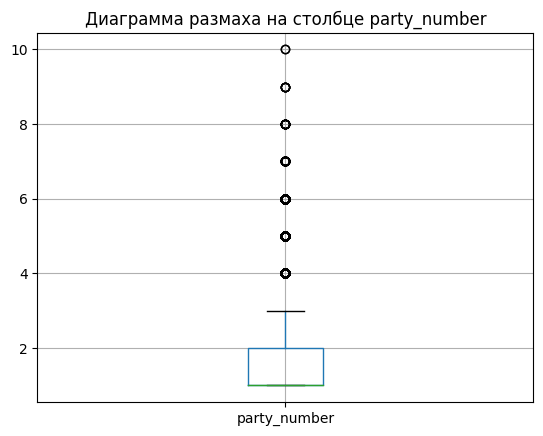

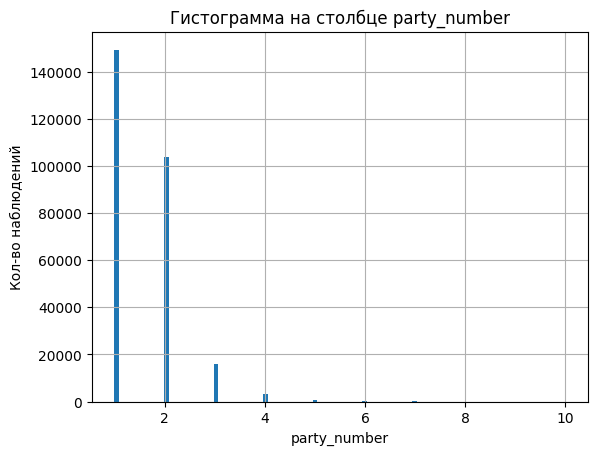

--------------------------------------------


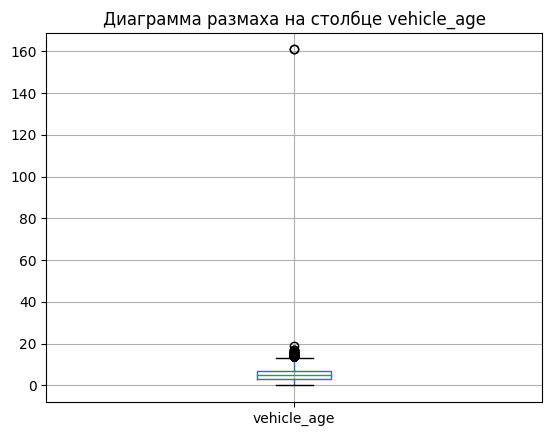

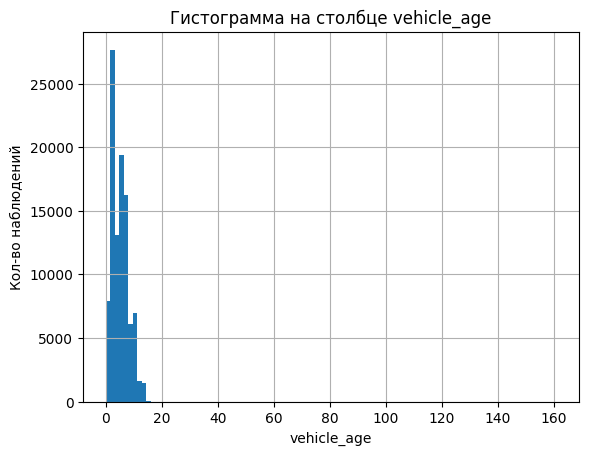

--------------------------------------------


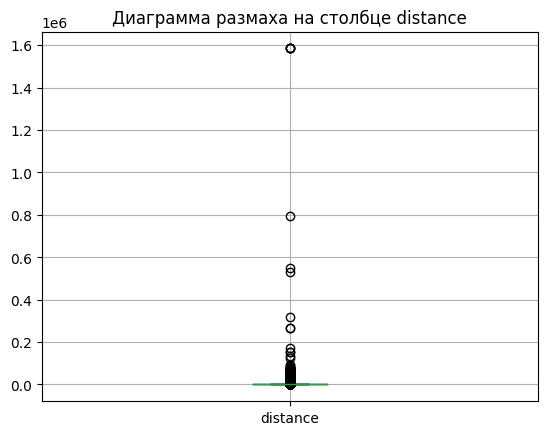

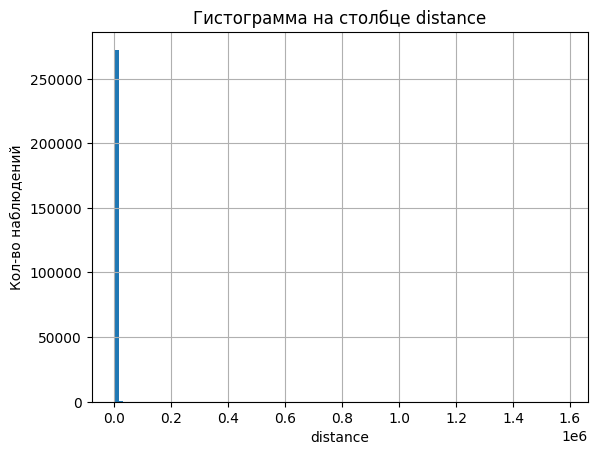

--------------------------------------------


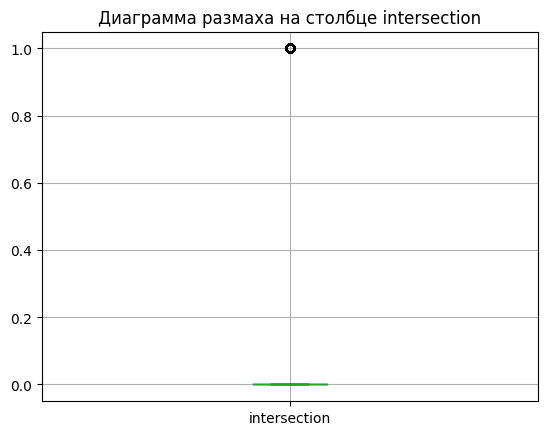

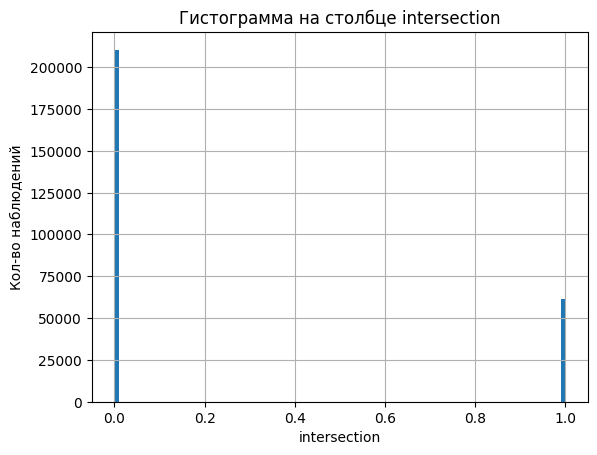

--------------------------------------------


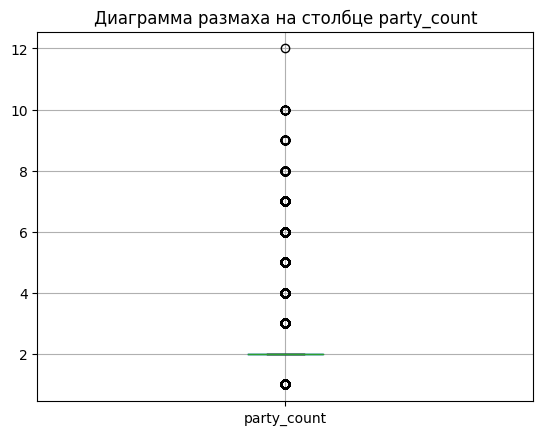

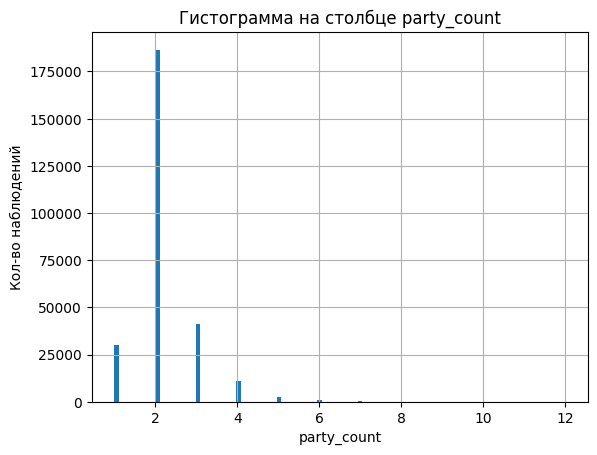

--------------------------------------------


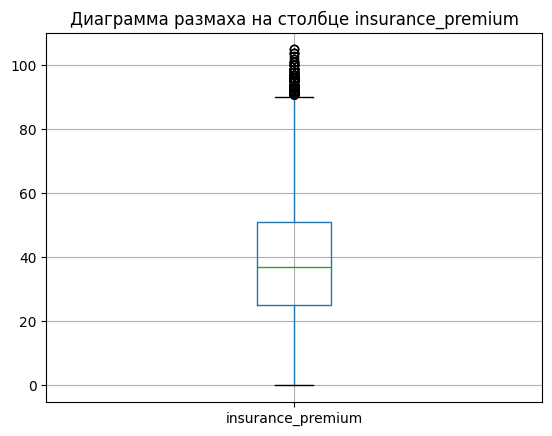

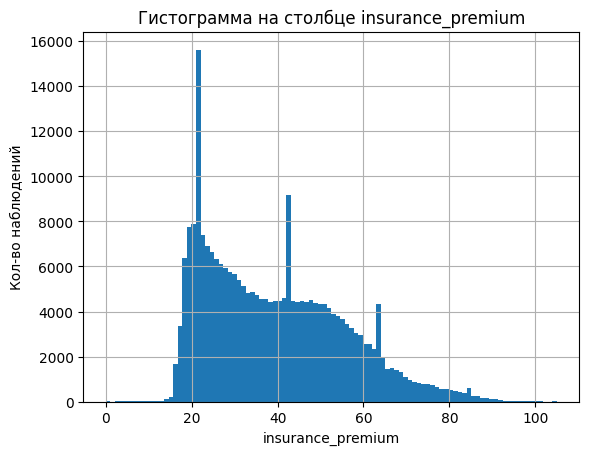

--------------------------------------------


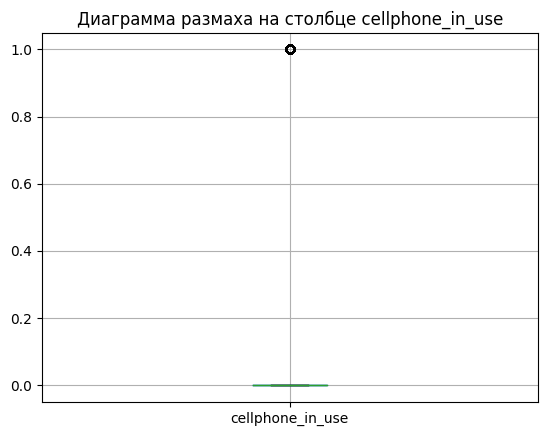

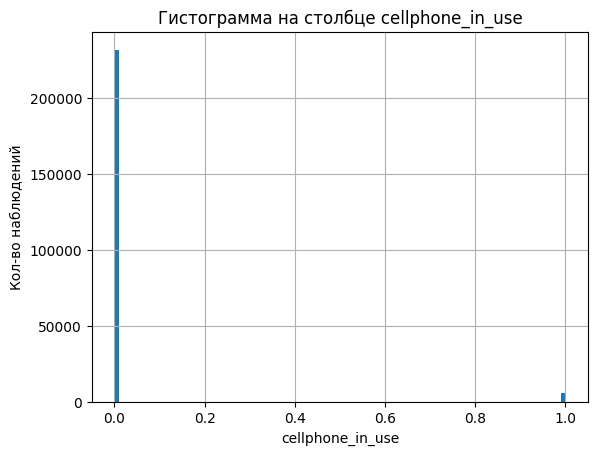

--------------------------------------------


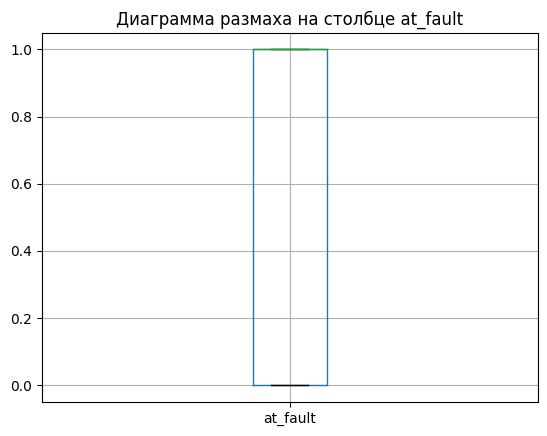

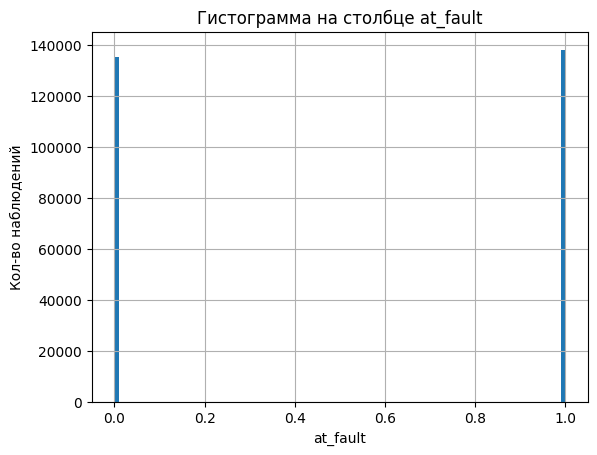

--------------------------------------------


In [37]:
data_spread(data, ['party_number', 'vehicle_age', 'distance', 'intersection', 'party_count', 'insurance_premium', 'cellphone_in_use', 'at_fault'])

In [38]:
uniqueness(data, ['vehicle_type', 'vehicle_transmission', 'county_location', 
       'direction', 'weather_1', 'location_type',
       'collision_damage', 'primary_collision_factor',
       'pcf_violation_category', 'type_of_collision',
       'motor_vehicle_involved_with', 'road_surface', 'road_condition_1',
       'lighting', 'control_device', 'party_sobriety', 'party_drug_physical', 'at_fault'])

Количество уникальных значений столбца vehicle_type: 3
[None 'coupe' 'sedan' 'other']
-----------------------------
Количество уникальных значений столбца vehicle_transmission: 2
[None 'manual' 'auto']
-----------------------------
Количество уникальных значений столбца county_location: 58
['riverside' 'san mateo' 'shasta' 'san diego' 'los angeles' 'placer'
 'contra costa' 'santa clara' 'monterey' 'kings' 'orange' 'san bernardino'
 'sonoma' 'colusa' 'alameda' 'merced' 'el dorado' 'sacramento' 'fresno'
 'santa barbara' 'tulare' 'madera' 'san luis obispo' 'stanislaus'
 'san joaquin' 'ventura' 'san francisco' 'marin' 'humboldt' 'inyo'
 'santa cruz' 'kern' 'napa' 'mono' 'lake' 'butte' 'yolo' 'nevada' 'solano'
 'amador' 'san benito' 'sutter' 'trinity' 'calaveras' 'glenn' 'siskiyou'
 'mendocino' 'yuba' 'del norte' 'alpine' 'tehama' 'plumas' 'tuolumne'
 'modoc' 'imperial' 'lassen' 'mariposa' 'sierra']
-----------------------------
Количество уникальных значений столбца direction: 4
[None 'sou

In [39]:
nan_values = []
nan_pres = []
data_nan_columns = []

for column in data:
    if  data[column].isna().sum() > 0:
        nan_values.append(data[column].isna().sum())
        nan_pres.append("{:.2%}".format(data[column].isna().sum()/len(data)))
        data_nan_columns.append(column)

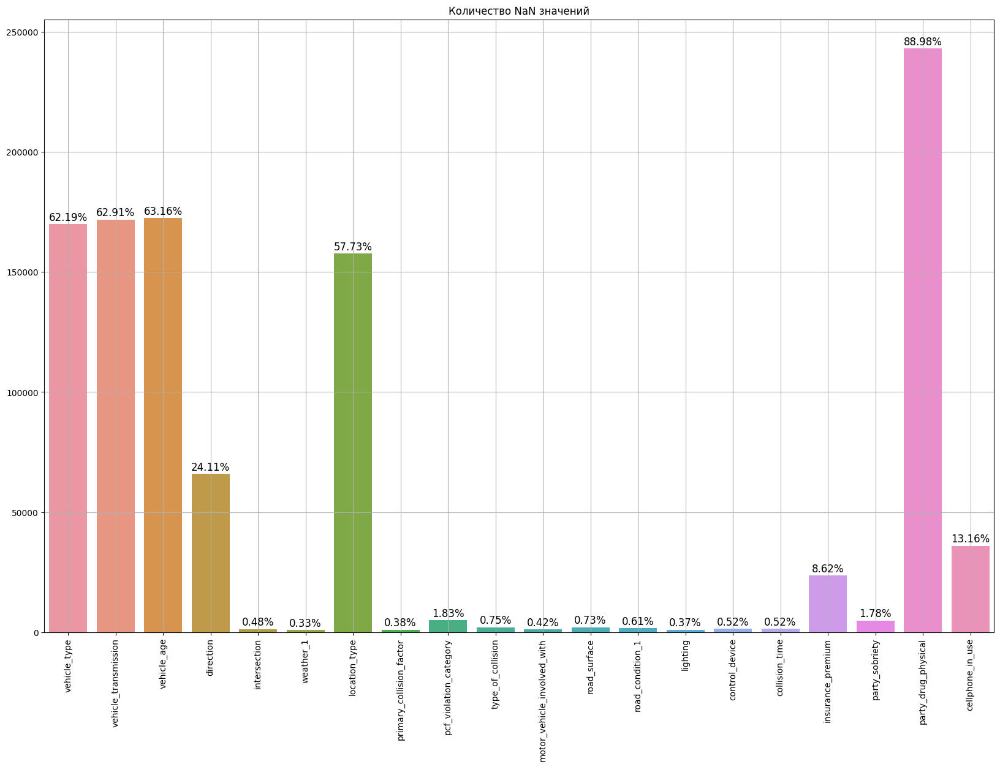

In [40]:
plt.figure(figsize=(20, 13))
plots = sns.barplot(x = data_nan_columns, y = nan_values)

for bar, pres in zip(plots.patches, nan_pres):
    plots.annotate(pres,
                   (bar.get_x() + bar.get_width() / 2,
                    bar.get_height()), ha='center', va='center',
                   size=12, xytext=(0, 8),
                   textcoords='offset points')
    
plt.title('Количество NaN значений')
plt.xticks(rotation=90)
plt.grid(True)
plt.show()

Проверим дисбаланс классов

In [41]:
display(data['at_fault'].value_counts(normalize=True))

1   0.51
0   0.49
Name: at_fault, dtype: float64

**Вывод**

При формировании итогового датафрема использовались первичные предположения заказчика:

- Выбран тип виновника — только машина (car).
- Отобраны случаи, когда ДТП привело к любым значимым повреждениям автомобиля любого из участников — все, кроме типа SCRATCH (царапина).
- Для моделирования взяты данные только за 2012 год.
- Подготовка исходной таблицы проводилась с помощью sql-запроса.

В итоге собран датафрейм с 28 столбцами и 273115 наблюдениями, с общим весом 58 МБ. Наименование столбцов не требует исправлений, дисбаланс классов в пределе нормы. Тип данных требует исправления у некоторых характеристик. Неявных дубликатов в этой выборке не замечено, однако, если внимательно просмотреть разброс по некоторым столбцам, то можно заметить аномалии, к примеру, возраст машины 160 лет, скорее всего опечатка из-за человеческого фактора и там должно быть 16 лет. Подобные аномалии необходимо исправить при предобработке данных. Также присутствуют много NaN значений, если попытаться удалить их все, то мы можем лишиться практически всех данных. Поэтому я предлагаю следующий выход:

- Категориальные данные с NaN значениями < 1% мы заполним модой
- Категориальные данные с NaN значениями > 1% мы заполним значением 'unknown'. Таким образом мы будем держать некий баланс между правдой и дополнениями
- Столбец cellphone_in_use мы сделаем категориальным, на места NaN поставим unknown, а числа заменим на Y и N, тогда у нас не будет дополнительной ложной информации
- В столбце insurance_premium можно заметить неких 3 моды - в районе 21, 43 и 65, однако наибольшее скопление данных лежит в диапазоне от 19 до 26, поэтому мы рандомно заполним NaN значения этим диапазоном.
- Столбец vehicle_age мы заполним медианным значением
- Все остальные NaN будут удалены. Это менее 1% или 2000 наблюдений.

### Предобработка данных

Заполнение модой категориальных данных со значением NaN менее 1%

In [42]:
for column in ['primary_collision_factor', 'weather_1', 'type_of_collision', 'motor_vehicle_involved_with', 'road_surface', 'road_condition_1', 'lighting', 'control_device']:
    data[column] = data[column].fillna(st.mode(data[column]))

Заполнение категориальные данные со значениями Nan более 1% значением unknown

In [43]:
for column in ['vehicle_transmission', 'direction', 'location_type', 'pcf_violation_category', 'party_sobriety', 'party_drug_physical']:
    data[column] = data[column].fillna('unknown')

In [44]:
for column in ['vehicle_type']:
    data[column] = data[column].fillna('other')

Столбец cellphone_in_use сделаем категориальным, на места NaN поставим unknown, а числа заменим на Y и N, тогда у нас не будет дополнительной ложной информации

In [45]:
def num_to_cat(x):
    if x == 1:
        return 'Y'
    elif math.isnan(x):
        return 'unknown'
    return 'N'
    
data['cellphone_in_use'] = data['cellphone_in_use'].apply(num_to_cat)

In [46]:
display(data['cellphone_in_use'].value_counts(normalize=True))

N         0.85
unknown   0.13
Y         0.02
Name: cellphone_in_use, dtype: float64

В столбце insurance_premium рандомно заполним NaN значения в диапазоне от 19 до 26

In [47]:
def premium_std(x):
    if not math.isnan(x):
        return x
    if math.isnan(x):
        return random.randint(19, 25)
    
data['insurance_premium'] = data['insurance_premium'].apply(premium_std)

Столбец vehicle_age заполним медианным значением

In [48]:
data['vehicle_age'] = data['vehicle_age'].fillna(data['vehicle_age'].median())

Все остальные NaN будут удалены.

In [49]:
data.dropna(inplace=True)

Изменим типы данных и некоторые аномалии.

In [50]:
for column in ['vehicle_age', 'distance', 'intersection', 'insurance_premium']:
    data[column] = data[column].astype('int')

In [51]:
for column in ['collision_date', 'collision_time']:
    data[column] = pd.to_datetime(data[column].astype(str))

In [52]:
data.loc[data['vehicle_age'] > 100, 'vehicle_age'] = data['vehicle_age'] // 10

In [53]:
data = data.loc[data['distance'] != 1584000]

Оставим из даты только месяц

In [54]:
month_list = {1 : 'Январь',
              2 : 'Февраль',
              3 : 'Март',
              4 : 'Апрель',
              5 : 'Май',
              6 : 'Июнь',
              7 : 'Июль',
              8 : 'Август',
              9 : 'Сентябрь',
              10 : 'Октябрь',
              11 : 'Ноябрь',
              12 : 'Декабрь'}

data['month'] = data['collision_date'].dt.month
del data['collision_date']

data['month'] = data['month'].replace(month_list)

Разделим время на интервалы

In [55]:
data['hour'] = data.collision_time.dt.hour

def time(x):
    if x < 6:
        return 'Ночь'
    elif x < 12:
        return 'Утро'
    elif x < 18:
        return 'День'
    return 'Вечер'

data['hour'] = data['hour'].apply(time)
del data['collision_time']

In [56]:
print('Количество неявных дубликатов =', data.duplicated().sum())
data.drop_duplicates(inplace = True)
print('Количество неявных дубликатов после удаления =', data.duplicated().sum())

Количество неявных дубликатов = 176
Количество неявных дубликатов после удаления = 0


In [57]:
uint8_columns = [
    'party_number', 'vehicle_age',
    'intersection', 'party_count',
    'at_fault'
]

uint16_columns = ['insurance_premium']

data = data.astype({
    **{_:'uint8' for _ in uint8_columns},
    **{_:'uint16' for _ in uint16_columns}
})

In [58]:
df_info(data, 'data')

Информация о data (кол-во столбцов 28, кол-во строк 270228)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 270228 entries, 0 to 273114
Data columns (total 28 columns):
 #   Column                       Non-Null Count   Dtype 
---  ------                       --------------   ----- 
 0   party_number                 270228 non-null  uint8 
 1   vehicle_type                 270228 non-null  object
 2   vehicle_transmission         270228 non-null  object
 3   vehicle_age                  270228 non-null  uint8 
 4   county_city_location         270228 non-null  object
 5   county_location              270228 non-null  object
 6   distance                     270228 non-null  int64 
 7   direction                    270228 non-null  object
 8   intersection                 270228 non-null  uint8 
 9   weather_1                    270228 non-null  object
 10  location_type                270228 non-null  object
 11  collision_damage             270228 non-null  object
 12  party_count

,party_number,vehicle_type,vehicle_transmission,vehicle_age,county_city_location,county_location,distance,direction,intersection,weather_1,...,road_condition_1,lighting,control_device,insurance_premium,party_sobriety,party_drug_physical,cellphone_in_use,at_fault,month,hour
0,1,other,unknown,5,3312,riverside,0,unknown,1,clear,...,normal,dark with street lights,functioning,27,"had been drinking, not under influence",unknown,N,1,Январь,Вечер
1,7,other,unknown,5,4109,san mateo,350,south,0,clear,...,normal,daylight,none,26,had not been drinking,unknown,N,0,Февраль,Утро
2,1,coupe,manual,2,4500,shasta,123,south,0,raining,...,normal,dark with street lights,none,17,had not been drinking,unknown,N,1,Январь,Вечер
3,3,coupe,manual,4,3711,san diego,51,west,0,clear,...,normal,dark with street lights,functioning,28,had not been drinking,unknown,N,0,Январь,Вечер
4,1,other,unknown,5,1934,los angeles,20,north,0,clear,...,normal,daylight,none,45,had not been drinking,unknown,N,1,Январь,День
5,3,other,unknown,5,3300,riverside,4224,west,0,clear,...,normal,dark with no street lights,none,23,had not been drinking,unknown,N,0,Февраль,Вечер
6,3,sedan,manual,12,1942,los angeles,50,east,0,clear,...,normal,daylight,none,40,had not been drinking,unknown,N,0,Февраль,Утро
7,1,coupe,manual,3,1955,los angeles,220,east,0,clear,...,normal,daylight,none,24,had not been drinking,unknown,N,1,Февраль,День
8,1,coupe,manual,3,3100,placer,16,east,0,cloudy,...,normal,dark with no street lights,none,20,had not been drinking,unknown,N,1,Февраль,Вечер
9,1,sedan,auto,0,0708,contra costa,690,west,0,clear,...,normal,daylight,none,34,had not been drinking,unknown,N,1,Февраль,Утро


None

,count,mean,std,min,25%,50%,75%,max
party_number,270228.00,1.55,0.70,1.00,1.00,1.00,2.00,10.00
vehicle_age,270228.00,5.08,1.86,0.00,5.00,5.00,5.00,19.00
distance,270228.00,582.75,3064.59,0.00,5.00,100.00,500.00,792000.00
intersection,270228.00,0.23,0.42,0.00,0.00,0.00,0.00,1.00
party_count,270228.00,2.17,0.76,1.00,2.00,2.00,2.00,12.00
insurance_premium,270228.00,37.84,16.27,0.00,24.00,34.00,49.00,105.00
at_fault,270228.00,0.50,0.50,0.00,0.00,1.00,1.00,1.00


**Вывод**

В результате предобработки данных было удалено менее 1% наблюдений, все остальные NaN значения были заполнены либо модой, либо медианным, либо unknown и other значениями. Столбцы 'vehicle_age', 'distance', 'intersection', 'insurance_premium' были переведены с float64 на int с определенной размерностью, что позволило чуть уменьшить размер датасета, а характеристики времени 'collision_date', 'collision_time' с типа данных object в DateTime. А также исправлена аномалия с возрастом равным 161 году на 16 лет, 'distance' == 1584000 было удалено из выборки. В итоге, после удаления неявных дубликатов, мы имеем обработанный датасет с 270.222 не нулевыми строками.

### Исследовательский анализ данных

Для нашего исследования не подходят некоторые признаки, например, PARTY_COUNT (количество участников), PARTY_NUMBER (номер участника проишествия) или PCF_VIOLATION_CATEGORY (категория нарушения), которые мы не будем знать изначально. Будем исходить от тех характеристик, которые нам известны на тот момент, когда человек только сел в машину и выбрал маршрут, например - погода или время суток.

Нам необходимо выбрать признаки, которые будут участвовать в дальнейшем обучении модели. Воспользуемся в том числе корреляцией Phik, которая отлично справляется с категориальными переменными, менее чувствителена к выбросам и может найти даже неленейную зависимость.


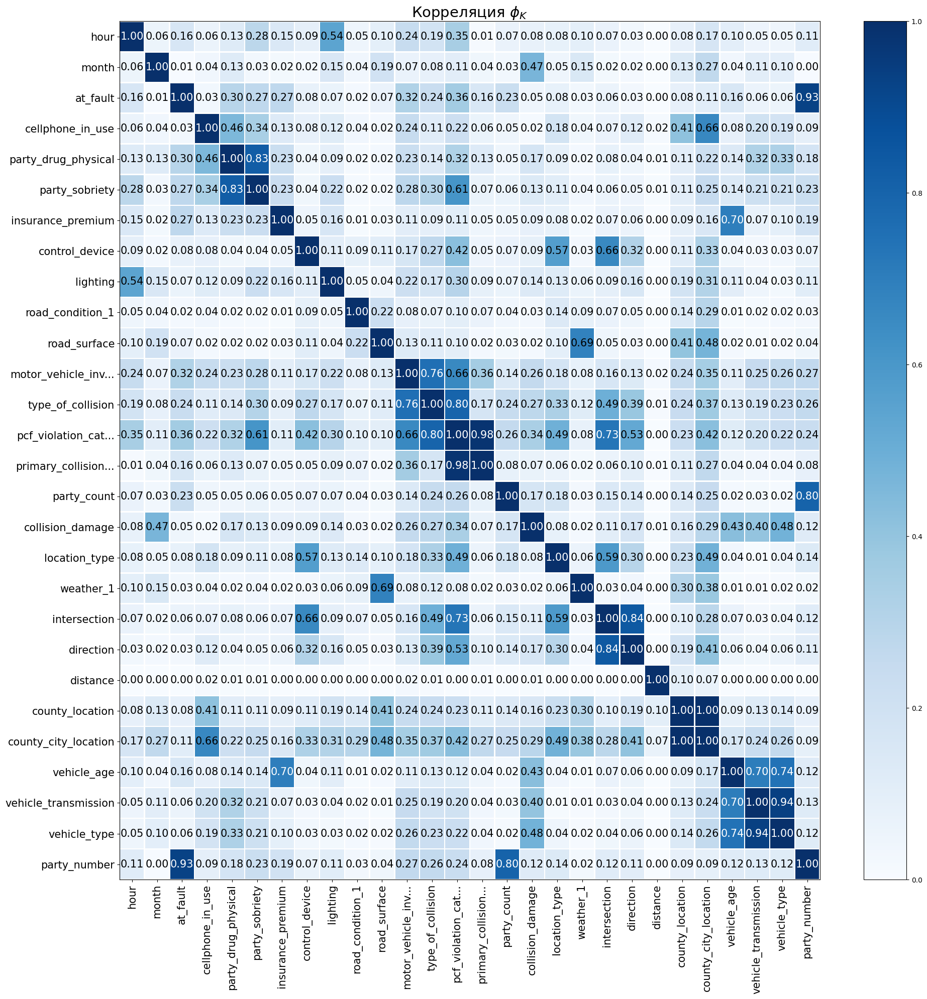

In [59]:
phik_overview = data.phik_matrix(interval_cols=['party_number', 'vehicle_age', 'distance', 'intersection', 'party_count', 'insurance_premium'])
phik_overview.round(2)

plot_correlation_matrix(phik_overview.values, 
                        x_labels=phik_overview.columns, 
                        y_labels=phik_overview.index, 
                        vmin=0, vmax=1, color_map="Blues", 
                        title=r"Корреляция $\phi_K$", 
                        fontsize_factor=1.5, 
                        figsize=(20, 20))
plt.tight_layout()
plt.show()

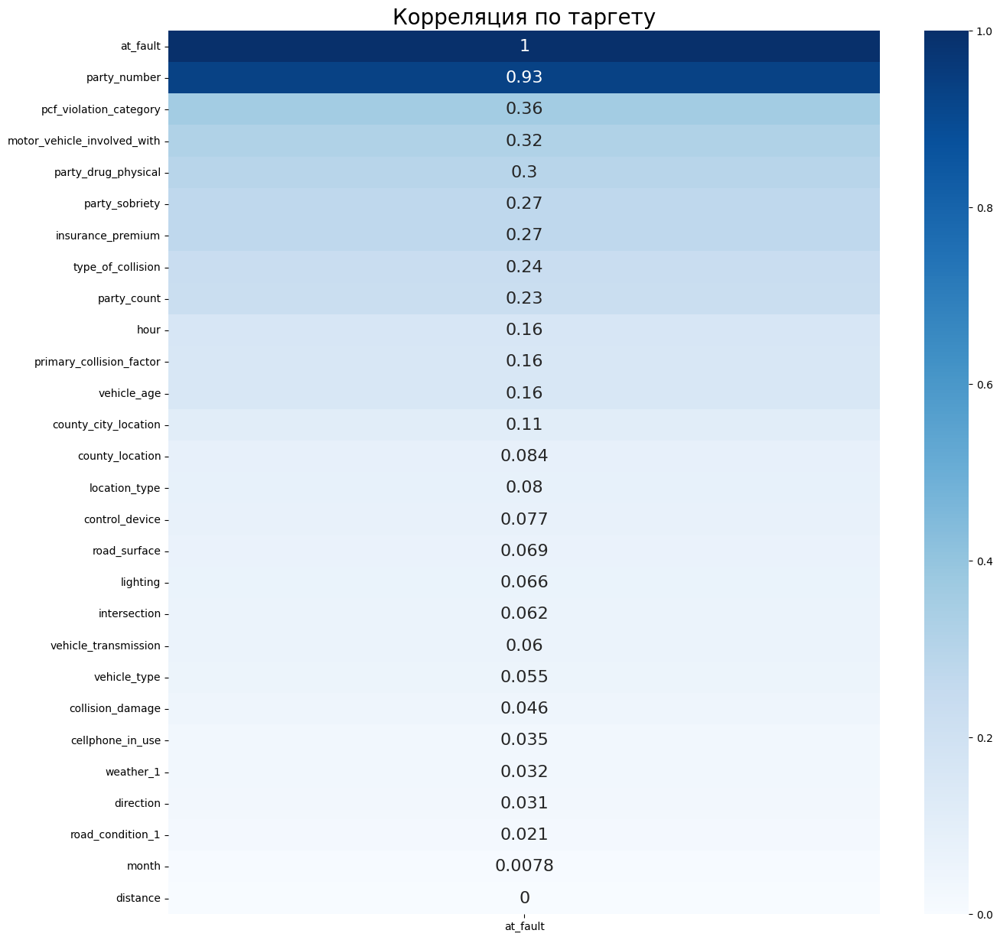

In [60]:
plt.figure(figsize=(15, 15))
sns.heatmap(phik_overview.sort_values(by = 'at_fault', ascending=False)[['at_fault']], cmap='Blues', annot=True, annot_kws={'size':16}, fmt='.2g')
plt.title('Корреляция по таргету', fontsize=20)
plt.show()

К необходимым для обучения столбцам можно отнести:

- insurance_premium (сумма страховки) - Сумма страховки может влиять на виновника проишествия. Водители с дешевой страховкой авто ездят менее аккуратно и чаще являются виновниками проишествий, в отличие от автомобилистов с дорогой страховкой машины.
- party_sobriety (Трезвость участника) -  Прямой фактор аварии, реакция ухудшена, состояние может быть любым : от головокружения, до потери зрения.
- party_drug_physical (состояние участника: физическое или с учётом принятых лекарств) - Некоторые лекарства могут вызвать головокружение, потерю внимательности, что приведёт к ухудшению реакции, возможна мультиколлениарность с признаком party_sobriety
- hour (время суток) - Данный столбец подробнее охватывает ситуацию с освещением в отличие от lighting.
- location_type (тип дороги) - На разных участках дороги возможны разные проишествия, однако при выезде на перекрёсток вероятность попасть в ДТП намного больше, чем на просторном шоссе.
- road_surface (состояние дороги) - Состояние дороги прямо влияет на манёвренность и на видимость, данные похожи на признак Погода	WEATHER_1, принято решение оставить один.
- road_condition_1 (дорожное состояние) - при высокой скорости ямы на дорогах или припятствия могут стать последствиями резкого манёвра, который приведёт к ДТП, а при сыпучем материале будет наименьшее сцепление с поверхностью дороги.
- county_location (названия географических районов, где произошло ДТП) - На ранее построенном графике мы увидели самые аварийные районы, количество ДТП в одних районах могут происходить чаще. Поэтому стоит добавить данный признак в нашу выборку.

In [61]:
X = data[['insurance_premium', 'party_sobriety', 'party_drug_physical', 
          'hour', 'location_type', 'road_surface', 'road_condition_1', 'lighting', 'county_location', 'at_fault']]
X.head(3)

,insurance_premium,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,at_fault
0,27,"had been drinking, not under influence",unknown,Вечер,unknown,dry,normal,dark with street lights,riverside,1
1,26,had not been drinking,unknown,Утро,highway,dry,normal,daylight,san mateo,0
2,17,had not been drinking,unknown,Вечер,unknown,wet,normal,dark with street lights,shasta,1


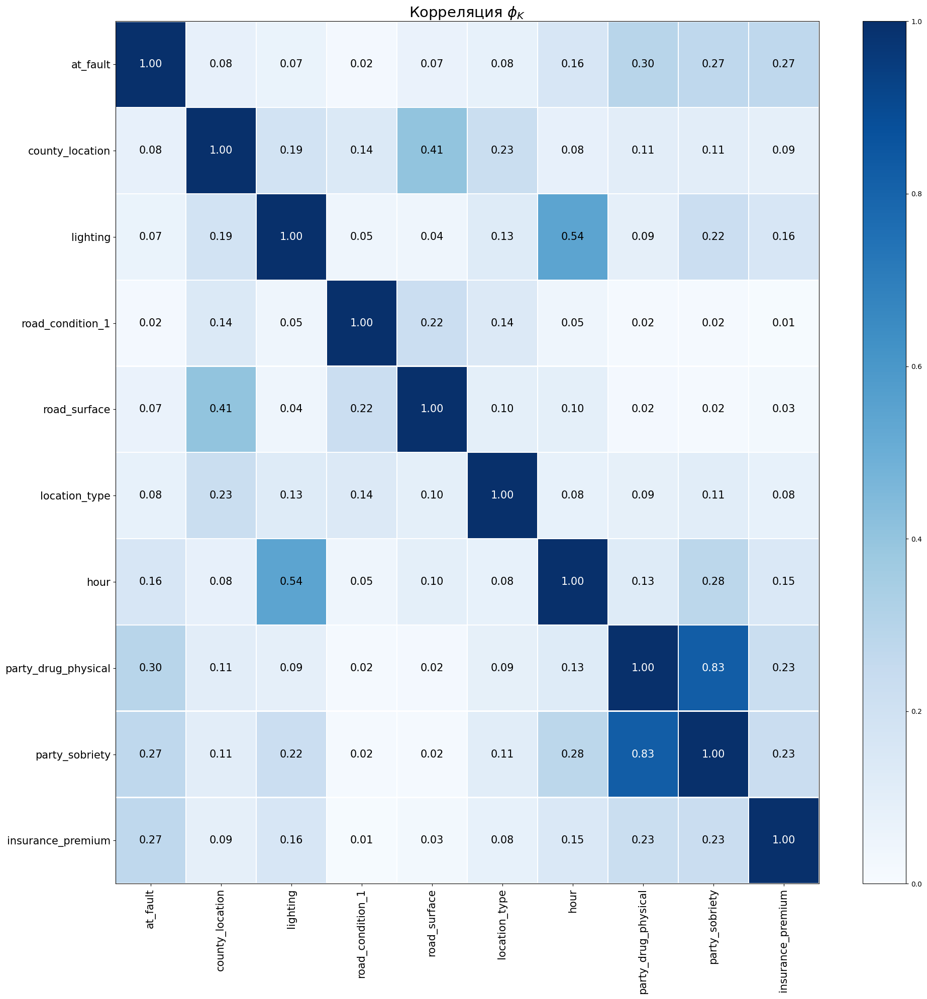

In [62]:
phik_overview = X.phik_matrix(interval_cols=['insurance_premium', 'vehicle_age'])
phik_overview.round(2)

plot_correlation_matrix(phik_overview.values, 
                        x_labels=phik_overview.columns, 
                        y_labels=phik_overview.index, 
                        vmin=0, vmax=1, color_map="Blues", 
                        title=r"Корреляция $\phi_K$", 
                        fontsize_factor=1.5, 
                        figsize=(20, 20))
plt.tight_layout()
plt.show()

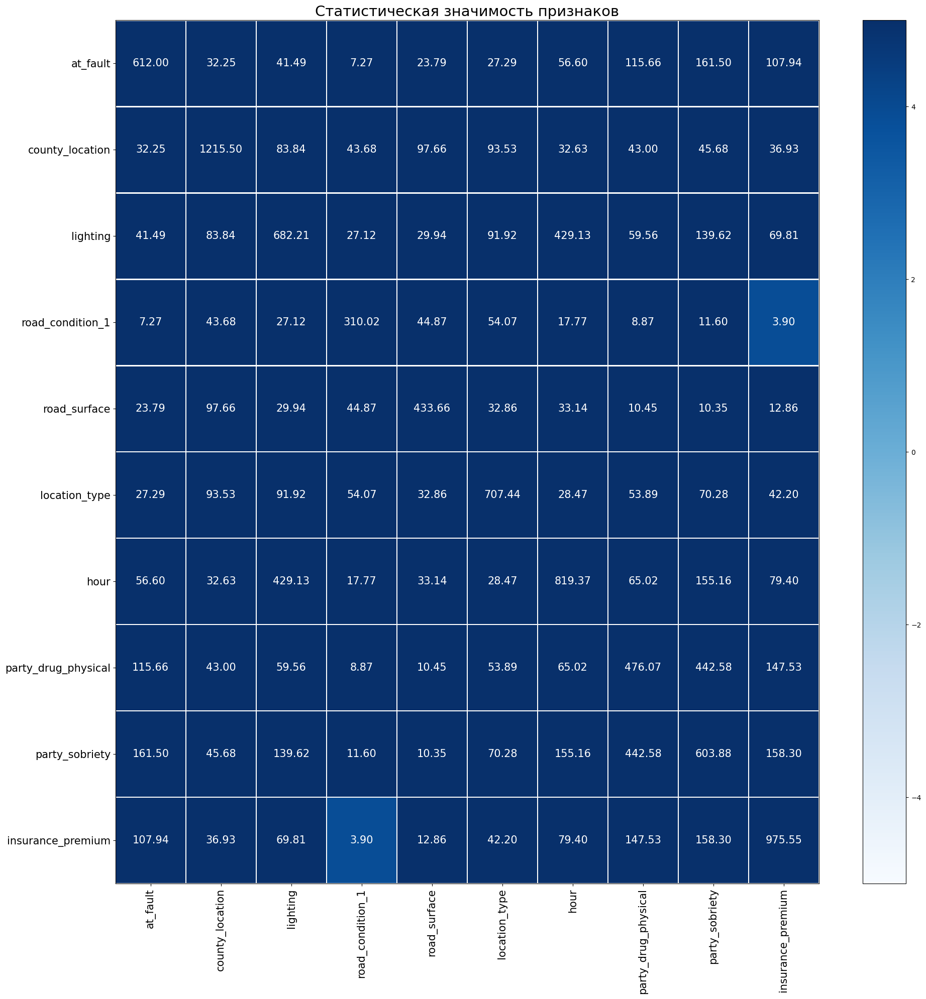

In [63]:
significance_overview = X.significance_matrix(interval_cols=['insurance_premium', 'vehicle_age'])
plot_correlation_matrix(significance_overview.fillna(0).values, 
                        x_labels=significance_overview.columns, 
                        y_labels=significance_overview.index, 
                        vmin=-5, vmax=5, title="Статистическая значимость признаков", 
                        usetex=False, fontsize_factor=1.5, figsize=(20, 20), color_map="Blues")
plt.tight_layout()

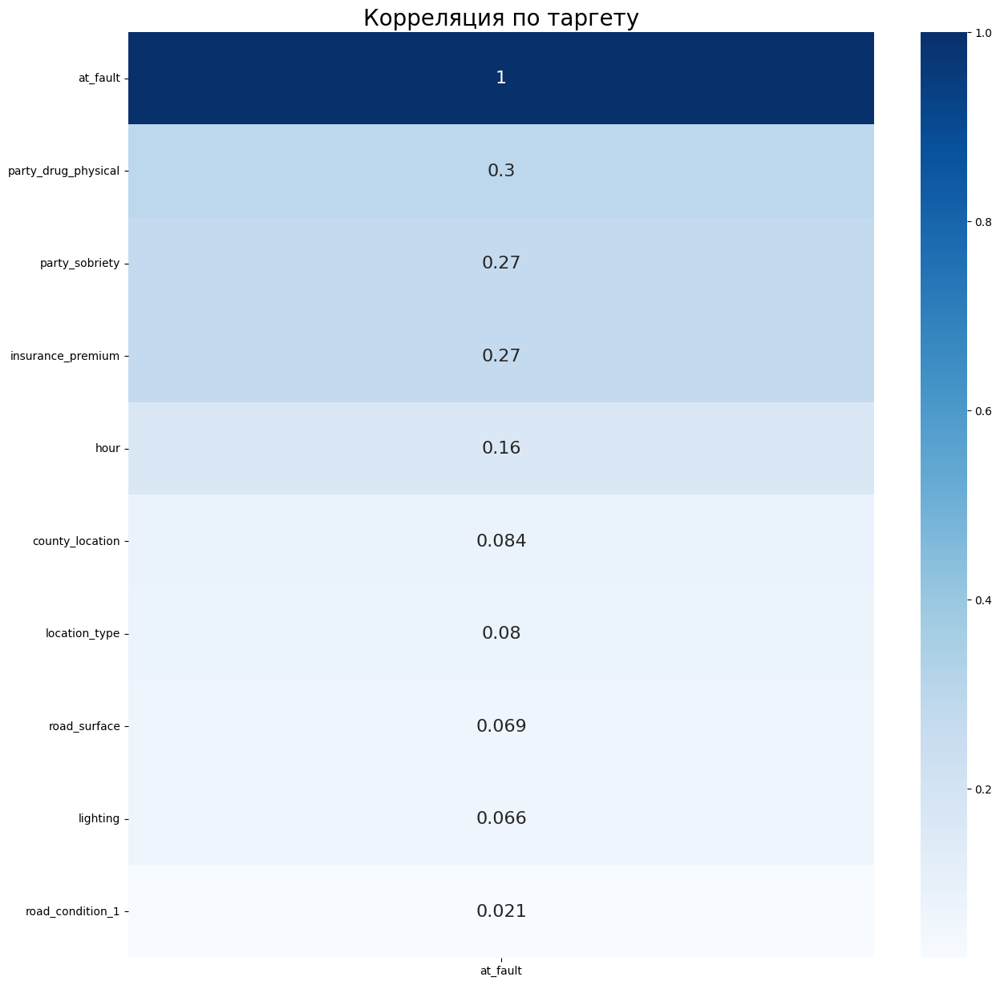

In [64]:
plt.figure(figsize=(15, 15))
sns.heatmap(phik_overview.sort_values(by = 'at_fault', ascending=False)[['at_fault']], cmap='Blues', annot=True, annot_kws={'size':16}, fmt='.2g')
plt.title('Корреляция по таргету', fontsize=20)
plt.show()

**Вывод**

Выбранные признаки не сильно коррелируют с целевым признаком. Мультиколлениарность между признаками party_sobriety и party_drug_physical, как и ожидалось присутсвует, между ними существует сильная статистическая значимость.

###  Нормализация входных данных

Подготовка обучающей, валидационной и тестовой выборок.

In [65]:
X_train, X_test_val, y_train, y_test_val = train_test_split(X.drop('at_fault', axis=1),
                                                    X['at_fault'],
                                                    test_size=0.3,
                                                    shuffle=True,
                                                    random_state=12345)

X_test, X_val, y_test, y_val = train_test_split(X_test_val,
                                                    y_test_val,
                                                    test_size=0.5,
                                                    shuffle=True,
                                                    random_state=12345)

print(X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape)

(189159, 9) (189159,) (40535, 9) (40535,) (40534, 9) (40534,)


In [66]:
print(f'Доля тренировочных признаков: {X_train.shape[0]/X.shape[0]:.2f}')
print(f'Доля тренировочных целей: {y_train.shape[0]/X.shape[0]:.2f}')
print(f'Доля валидационных признаков: {X_val.shape[0]/X.shape[0]:.2f}')
print(f'Доля валидационных целей: {y_val.shape[0]/X.shape[0]:.2f}')
print(f'Доля тестовых признаков: {X_test.shape[0]/X.shape[0]:.2f}')
print(f'Доля тестовых целей: {y_test.shape[0]/X.shape[0]:.2f}')
print(f'Доля положительных целей на тренировочных данных: {y_train.astype("int").mean():.2f}')
print(f'Доля положительных целей на валидационных данных: {y_val.astype("int").mean():.2f}')
print(f'Доля положительных целей на тестовых данных: {y_test.astype("int").mean():.2f}')

Доля тренировочных признаков: 0.70
Доля тренировочных целей: 0.70
Доля валидационных признаков: 0.15
Доля валидационных целей: 0.15
Доля тестовых признаков: 0.15
Доля тестовых целей: 0.15
Доля положительных целей на тренировочных данных: 0.50
Доля положительных целей на валидационных данных: 0.50
Доля положительных целей на тестовых данных: 0.51


In [67]:
numeric = ['insurance_premium']
categories = ['party_sobriety', 'party_drug_physical', 'hour', 'location_type', 
              'road_surface', 'road_condition_1', 'lighting', 'county_location']

In [68]:
encoder = OrdinalEncoder(handle_unknown='error')

result_train = encoder.fit_transform(X_train[categories])
result_train = pd.DataFrame(result_train, columns=encoder.get_feature_names_out(categories),\
                                                                    index=X_train.index)
X_train = result_train.join(X_train[numeric])
X_train.head()

,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,insurance_premium
202503,6.00,5.00,0.00,3.00,0.00,4.00,3.00,18.00,22
94319,3.00,5.00,3.00,3.00,0.00,4.00,4.00,38.00,16
52839,3.00,5.00,3.00,3.00,0.00,4.00,3.00,42.00,77
14860,3.00,5.00,3.00,3.00,0.00,4.00,3.00,29.00,32
145380,3.00,5.00,1.00,0.00,0.00,0.00,3.00,18.00,20


In [69]:
result_val = encoder.transform(X_val[categories])
result_val = pd.DataFrame(result_val, columns=encoder.get_feature_names_out(categories),\
                                                                    index=X_val.index)
X_val = result_val.join(X_val[numeric])
X_val.head()

,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,insurance_premium
10271,4.00,0.00,1.00,3.00,0.00,3.00,4.00,18.00,21
119253,6.00,5.00,1.00,0.00,0.00,4.00,3.00,20.00,21
266840,3.00,5.00,0.00,3.00,0.00,4.00,1.00,29.00,19
216961,3.00,5.00,1.00,3.00,0.00,2.00,3.00,47.00,20
111514,3.00,5.00,1.00,2.00,0.00,4.00,3.00,18.00,31


In [70]:
result_test = encoder.transform(X_test[categories])
result_test = pd.DataFrame(result_test, columns=encoder.get_feature_names_out(categories),\
                                                                    index=X_test.index)
X_test = result_test.join(X_test[numeric])
X_test.head()

,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,insurance_premium
91045,3.00,5.00,1.00,0.00,0.00,4.00,1.00,0.00,53
39960,3.00,5.00,0.00,0.00,0.00,4.00,0.00,36.00,36
216126,3.00,5.00,0.00,3.00,0.00,4.00,1.00,18.00,44
222166,3.00,5.00,1.00,3.00,0.00,4.00,3.00,18.00,20
185570,3.00,5.00,1.00,0.00,0.00,4.00,3.00,18.00,44


In [71]:
scaler = StandardScaler().fit(X_train[numeric])

In [72]:
X_train[numeric] = scaler.transform(X_train[numeric])

In [73]:
X_test[numeric] = scaler.transform(X_test[numeric])

In [74]:
X_val[numeric] = scaler.transform(X_val[numeric])

In [75]:
display(X_train.describe(), X_test.describe(), X_val.describe())

,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,insurance_premium
count,189159.00,189159.00,189159.00,189159.00,189159.00,189159.00,189159.00,189159.00,189159.00
mean,3.08,4.53,1.43,1.86,0.30,3.94,2.46,26.65,0.00
std,0.63,1.42,1.12,1.40,0.89,0.56,1.04,12.95,1.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-2.32
25%,3.00,5.00,1.00,0.00,0.00,4.00,1.00,18.00,-0.85
50%,3.00,5.00,1.00,3.00,0.00,4.00,3.00,29.00,-0.24
75%,3.00,5.00,3.00,3.00,0.00,4.00,3.00,36.00,0.69
max,6.00,5.00,3.00,3.00,3.00,7.00,4.00,57.00,4.06


,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,insurance_premium
count,40534.00,40534.00,40534.00,40534.00,40534.00,40534.00,40534.00,40534.00,40534.00
mean,3.08,4.53,1.43,1.85,0.29,3.94,2.46,26.65,0.00
std,0.63,1.42,1.12,1.41,0.89,0.55,1.05,13.01,1.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-2.32
25%,3.00,5.00,1.00,0.00,0.00,4.00,1.00,18.00,-0.85
50%,3.00,5.00,1.00,3.00,0.00,4.00,3.00,29.00,-0.24
75%,3.00,5.00,3.00,3.00,0.00,4.00,3.00,36.00,0.75
max,6.00,5.00,3.00,3.00,3.00,7.00,4.00,57.00,3.82


,party_sobriety,party_drug_physical,hour,location_type,road_surface,road_condition_1,lighting,county_location,insurance_premium
count,40535.00,40535.00,40535.00,40535.00,40535.00,40535.00,40535.00,40535.00,40535.00
mean,3.08,4.54,1.44,1.84,0.30,3.94,2.47,26.65,-0.00
std,0.63,1.41,1.12,1.41,0.89,0.55,1.04,12.91,1.00
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-2.32
25%,3.00,5.00,1.00,0.00,0.00,4.00,1.00,18.00,-0.85
50%,3.00,5.00,1.00,3.00,0.00,4.00,3.00,29.00,-0.24
75%,3.00,5.00,3.00,3.00,0.00,4.00,3.00,36.00,0.69
max,6.00,5.00,3.00,3.00,3.00,7.00,4.00,57.00,4.12


###  Поиск лучшей модели

В данном исследовании стоит задача бинарной классификации, для неё подходят следующие метрики оценки качества моделей: precision, recall и f1 мера. 

Precision можно интерпретировать как долю объектов, названных классификатором положительными и при этом действительно являющимися положительными.

Recall показывает, какую долю объектов положительного класса из всех объектов положительного класса нашел алгоритм.

Так как у нас необходимо угадать будет ли являться наш клиент виновником проишествия, то мы выберем метрику recall.

Создадим таблицу для добавления значений времени и recall.

В следующих пунктах подбор гиперпараметров будет закомменчен, из-за длительности обработки кода.


In [76]:
analytics = pd.DataFrame(columns=['Recall', 'LearningTime', 'PredictTime'])
analytics

,Recall,LearningTime,PredictTime


**DecisionTreeClassifier**

In [77]:
#grid = {'max_depth' : np.arange(6, 18),
#    'criterion' : ['gini', 'entropy']
#}

#dt = GridSearchCV(DecisionTreeClassifier(random_state=SEED),
#                     grid, cv = 5, scoring = 'recall')
#dt.fit(X_train, y_train)
#dt.best_params_

In [78]:
import time
model_dtr, learning_time_dtr = learning_time(DecisionTreeClassifier(criterion = 'gini', max_depth = 6, random_state=SEED),
                                             X_train, y_train)
predicts_dtr, predict_time_dtr = predict_time(model_dtr, X_val)
recall_dtr = "{:.2%}".format(recall_score(y_val, predicts_dtr))
alter_table(analytics, 'DecisionTreeClassifier', recall_dtr, learning_time_dtr, predict_time_dtr)

,Recall,LearningTime,PredictTime
DecisionTreeClassifier,50.56%,0.27,0.01


**RandomForestClassifier**

In [79]:
#grid = { 
#    'n_estimators': [40, 50, 60, 70],
#    'max_depth' : np.arange(6, 18),
#    'criterion' : ['gini']
#}

#rf = GridSearchCV(RandomForestClassifier(random_state=SEED),
#                     grid, cv = 5, scoring = 'recall')
#rf.fit(X_train, y_train)
#rf.best_params_

In [80]:
model_rfr, learning_time_rfr = learning_time(RandomForestClassifier(criterion = 'gini', max_depth = 17, n_estimators = 60, random_state=SEED),
                                             X_train, y_train)
predicts_rfr, predict_time_rfr = predict_time(model_rfr, X_val)
recall_rfr = "{:.2%}".format(recall_score(y_val, predicts_rfr))
alter_table(analytics, 'RandomForestClassifier', recall_rfr, learning_time_rfr, predict_time_rfr)

,Recall,LearningTime,PredictTime
DecisionTreeClassifier,50.56%,0.27,0.01
RandomForestClassifier,49.47%,11.61,0.44


**CatBoostClassifier**

In [81]:
#model_cbr = CatBoostClassifier(loss_function='Logloss', silent=True, learning_rate=0.1, n_estimators=100, random_state=SEED)
#parameters_cbr = {'max_depth':np.arange(8, 15)}
#catboost_grid = model_cbr.grid_search(parameters_cbr,
#            X_train, y_train,
#            cv=3,
#            plot=False)

In [82]:
model_cbr, learning_time_cbr = learning_time(CatBoostClassifier(loss_function='Logloss', n_estimators=100, silent=True, depth = 12),
                                             X_train, y_train)
predicts_cbr, predict_time_cbr = predict_time(model_cbr, X_val)
recall_cbr = "{:.2%}".format(recall_score(y_val, predicts_cbr))
alter_table(analytics, 'CatBoostClassifier', recall_cbr, learning_time_cbr, predict_time_cbr)

,Recall,LearningTime,PredictTime
DecisionTreeClassifier,50.56%,0.27,0.01
RandomForestClassifier,49.47%,11.61,0.44
CatBoostClassifier,51.04%,6.15,0.03


**XGBClassifier**

In [83]:
#parameters = {
#    'max_depth': np.arange(6, 18)
#}

#xgb = GridSearchCV(
#    estimator=xgboost.XGBClassifier(loss_function='Logloss', n_estimators=100, random_state=SEED, learning_rate = 0.1),
#    param_grid=parameters,
#    scoring = 'recall',
#    n_jobs = 10,
#    cv = 10,
#    verbose=True
#)

#xgb.fit(X_train, y_train)

In [84]:
#xgb.best_params_

In [85]:
model_xgb, learning_time_xgb = learning_time(xgboost.XGBClassifier(loss_function='Logloss', n_estimators=100, random_state=SEED, learning_rate = 0.1, max_depth = 6),
                                             X_train, y_train)
predicts_xgb, predict_time_xgb = predict_time(model_xgb, X_val)
recall_xgb = "{:.2%}".format(recall_score(y_val, predicts_xgb))
alter_table(analytics, 'XGBoost', recall_xgb, learning_time_xgb, predict_time_xgb)

[01:49:08] WARNING: /Users/runner/work/xgboost/xgboost/python-package/build/temp.macosx-10.9-x86_64-cpython-38/xgboost/src/learner.cc:767: 
Parameters: { "loss_function" } are not used.



,Recall,LearningTime,PredictTime
DecisionTreeClassifier,50.56%,0.27,0.01
RandomForestClassifier,49.47%,11.61,0.44
CatBoostClassifier,51.04%,6.15,0.03
XGBoost,50.74%,12.06,0.05


**Вывод**

In [86]:
analytics

,Recall,LearningTime,PredictTime
DecisionTreeClassifier,50.56%,0.27,0.01
RandomForestClassifier,49.47%,11.61,0.44
CatBoostClassifier,51.04%,6.15,0.03
XGBoost,50.74%,12.06,0.05


Модели градиентного бустинга суммарно выигрывают у деревянных моделей, однако случайный лес идёт с ними почти в ровень, что не может не радовать. При выборе модели необходимо ориентироваться не только на точность нашей главной метрики, но и на скорость предсказания, для удобства клиента. Поэтому выбором будет CatBoost, который выиграл у всех по метрике recall, а также не отступает по времени предсказания.

## Проведите анализ важности факторов ДТП

Проверка лучшей модели на тестовых данных

In [87]:
best_model = CatBoostClassifier(loss_function='Logloss', n_estimators=100, silent=True, depth = 12).fit(X_train, y_train)
predicts = best_model.predict(X_test)
print(f'Метрика Recall на тестовых данных = {"{:.2%}".format(recall_score(y_test, predicts))}')
print(f'Метрика Precision на тестовых данных = {"{:.2%}".format(precision_score(y_test, predicts))}')
print(f'Метрика F1 на тестовых данных = {"{:.2%}".format(f1_score(y_test, predicts))}')

Метрика Recall на тестовых данных = 50.52%
Метрика Precision на тестовых данных = 69.08%
Метрика F1 на тестовых данных = 58.36%


Проведём графический анализ матрицы ошибок. Выведем полноту и точность на график.

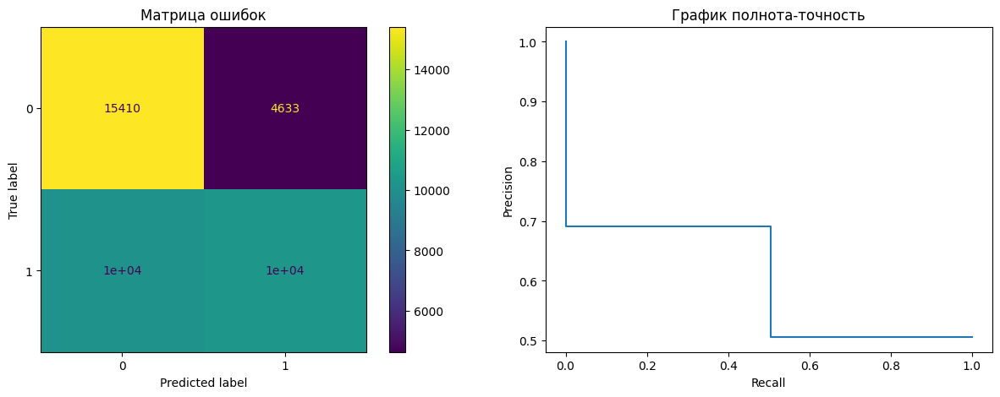

In [88]:
cm = confusion_matrix(y_test, predicts, labels=best_model.classes_)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
cmd = ConfusionMatrixDisplay(cm, display_labels=best_model.classes_)
cmd.plot(ax=ax1)
ax1.set_title('Матрица ошибок')
prec, recall, _ = precision_recall_curve(y_test, predicts)
PrecisionRecallDisplay(prec, recall).plot(ax=ax2)
ax2.set_title('График полнота-точность')
plt.show()

Для анализа факторов влияющих на вероятность стать виновником ДТП воспользуемся библиотекой SHAP.

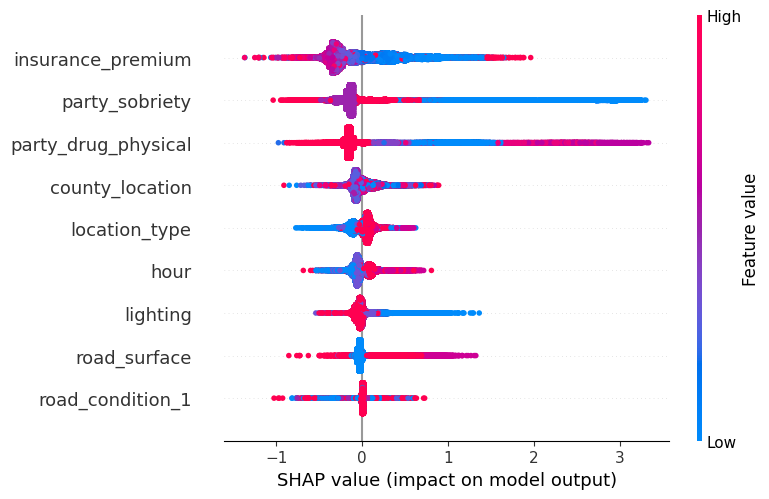

In [89]:
explainer = shap.TreeExplainer(best_model)
shap_values = explainer.shap_values(X_train)

shap.summary_plot(shap_values, X_train)

В абсолютных величинах на решение о виновности в ДТП больше всего влияют:

insurance_premium (страховка машины) - Сумма страховки может влиять на виновника проишествия. Наблюдается явный пик около минимальной суммы страховки автомобиля. Водители с низкой страховкой авто ездят менее аккуратно и чаще являются виновниками ДТП. 

party_sobriety и party_drug_physical (трезвость и состояние участника) - очень схожие между собой признаки, решение данных проблем уже есть на рынке, вот как можно оборудовать машину:
необходимо оборудовать автомобиль анализатором опьянения и главным фктором к запуску двигателя будет процент вещества в организме. А чтобы мы понимали, что именно этот человек "дует в трубочку", поставим камеру или он будет снимать на телефон доказательства.

Hour (время суток) - чаще всего модель смотрит именно на ночное время суток:
Составлять в приложении маршруты таким образом, чтобы большая часть дороги была с освещением.

Погодные условия и состояние дорог одинаковые для участников движения, и все же проанализируем зависимость вероятности стать виновником ДТП от региона и от типа дороги. 

In [90]:
fig = px.histogram(
    X, x='county_location', color='at_fault',
    barmode='group',
    title='Зависимость виновности в ДТП от географических районов, где произошло ДТП',
    histfunc='count'
)
fig.show()

In [91]:
fig = px.histogram(
    X, x='location_type', color='at_fault',
    barmode='group',
    title='Зависимость виновности в ДТП от типа дороги',
    histfunc='count'
)
fig.show()

Если отвечать на первоначальный вопрос: "возможно создание адекватной системы оценки риска при выдаче авто?", то выданных данных недостаточно. Большинство факторов из выборки будут известны только после проишествия. Нам же нужны совсем иные данные, которые мы будем знать только, когда человек сел в машину и выбрал маршрут. Например, можно добавить в таблицу признаков клиента следующие факторы:

- возраст водителя, который будет прямо влиять на время реакции
- место работы
- среднюю скорость движения
- количество нарушений за всё время
- стаж, от этого будет зависить как он поведёт себя в той или иной ситуации.

## Выводы

В ходе исследования удалось обучить модель на тестовых данных и получить метрику Recall равную 51%, precision - 70%, а f1 - 59%. Это недостаточно хорошие показатели, 
однако на предсказаниях мы получаем следующие результаты:

- неправильно угадываем около 11 % данных, которые относятся к первому классу
- будем угадывать класс 1 - в районе 25% данных.
- чаще всего мы будем угадывать класс 0 - в 38% от случая.
- оставшиеся 26% - неудачные предсказания класса 0.

В данной работе мы попытались создать систему для каршеринговой компании, которая могла бы оценить риск ДТП по совокупности факторов.

Мы исследовали предоставленную базу, провели статистический анализ некоторых факторов.

Подготовили данные для анализа за 2012 год. Опробовали ряд моделей классического машинного обучения и бустингов.

Испытанные модели показали, что внедрение данных систем позволит в некоторой степени улучшить вероятность опознать потенциального виновника ДТП по ряду признаков.

Мы увидели что самыми влияющими факторами являются :

- страховка машины
- трезвость и состояние водителя
- время суток

Мы показали, что сам факт региона влияет на вероятность попасть в аварию, для типа дороги однозначного ответа нет, так как данных недостаточно, слишком много неизвестных значений.

Общий вклад трезвости и влияния лекарств довольно велик и его стоит учитывать. В машины стоит установить контрольное устройство. Возможно, добавить в камеру систему определения физического состояния водителя по времени реакции на раздражители, скорость моргания и сфокусированность зрения на дороге с включением звуковой сигнализации если водитель начинает спать или долго не смотрит на дорогу.